In [1]:
from _src import *
from verde_source import regular, interp_at

from tqdm import tqdm
from shapely.ops import transform
from pylab import *
from shapely.geometry import Point, Polygon

import verde as vd
import matplotlib.patches as patches

import matplotlib.pyplot as plt
import pandas as pd
import numpy as np 
import geopandas as gpd
import pyproj
import os

import cartopy.crs as ccrs
import cartopy.feature as cfeature

In [2]:
import warnings
warnings.filterwarnings("ignore")
%load_ext autoreload
%autoreload 2
%matplotlib inline

In [3]:
list_geof = os.listdir('/home/database/geof/')
list_geof

['mag_line_1105',
 'mag_1039',
 'gama_line_1105',
 'mag_line_1089',
 'gama_1039',
 'mag_3022',
 'mag_1105',
 'mag_tie_1105',
 'gama_1039_mdt.csv',
 'gama_line_1089',
 'gama_3022',
 'gama_line_1092',
 'geof_1039']

# Construindo Quadrícula

In [6]:
ID_LISTS = pd.read_csv('/home/database/test.csv')
ID_LISTS

,fid,folha_id,epsg
0,19925,SC23_YB_VI4SE,32723
1,19926,SC23_ZA_IV3SW,32723
2,19927,SC23_ZA_IV3SE,32723
3,19928,SC23_ZA_IV4SW,32723
4,20175,SC23_ZA_IV3NW,32723
5,20176,SC23_ZA_IV3NE,32723
6,20177,SC23_ZA_IV4NW,32723
7,20178,SC23_ZA_IV4NE,32723
8,20179,SC23_ZA_V3NW,32723
9,20430,SC23_ZA_IV1SE,32723


In [11]:
LISTA=list(ID_LISTS['folha_id'])

In [13]:
LISTA

['SC23_YB_VI4SE',
 'SC23_ZA_IV3SW',
 'SC23_ZA_IV3SE',
 'SC23_ZA_IV4SW',
 'SC23_ZA_IV3NW',
 'SC23_ZA_IV3NE',
 'SC23_ZA_IV4NW',
 'SC23_ZA_IV4NE',
 'SC23_ZA_V3NW',
 'SC23_ZA_IV1SE',
 'SC23_ZA_IV2SW',
 'SC23_ZA_IV2SE',
 'SC23_ZA_V1SW',
 'SC23_ZA_IV2NW',
 'SC23_ZA_IV2NE',
 'SC23_ZA_V1NW']

In [15]:
LISTA=['SC23_YB_VI4_SE',
 'SC23_ZA_IV3_SW',
 'SC23_ZA_IV3_SE',
 'SC23_ZA_IV4_SW',
 'SC23_ZA_IV3_NW',
 'SC23_ZA_IV3_NE',
 'SC23_ZA_IV4_NW',
 'SC23_ZA_IV4_NE',
 'SC23_ZA_V3_NW',
 'SC23_ZA_IV1_SE',
 'SC23_ZA_IV2_SW',
 'SC23_ZA_IV2_SE',
 'SC23_ZA_V1S_W',
 'SC23_ZA_IV2_NW',
 'SC23_ZA_IV2_NE',
 'SC23_ZA_V1_NW']

In [16]:
#quadricula = Build_mc(escala='250k',ID=['S','N'],verbose=True)
quadricula = Build_mc(escala='25k',ID=LISTA,verbose=True)

100%|████████████████████████████████████████| 16/16 [00:00<00:00, 70.60it/s]


 - Folhas selecionadas:


15it [00:00, 332.24it/s]

"SC23_YB_VI4_SE"
"SC23_ZA_IV3_SW"
"SC23_ZA_IV3_SE"
"SC23_ZA_IV4_SW"
"SC23_ZA_IV3_NW"
"SC23_ZA_IV3_NE"
"SC23_ZA_IV4_NW"
"SC23_ZA_IV4_NE"
"SC23_ZA_V3_NW"
"SC23_ZA_IV1_SE"
"SC23_ZA_IV2_SW"
"SC23_ZA_IV2_SE"
"SC23_ZA_IV2_NW"
"SC23_ZA_IV2_NE"
"SC23_ZA_V1_NW"

  15 folhas adicionadas.


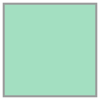

In [22]:
quadricula['SC23_YB_VI4_SE']['folha']['geometry']

In [20]:
lito_100k = importar_geometrias('litologia_100k')

In [ ]:
lito_100k.intersection()

NameError: name 'lito_recortado' is not defined

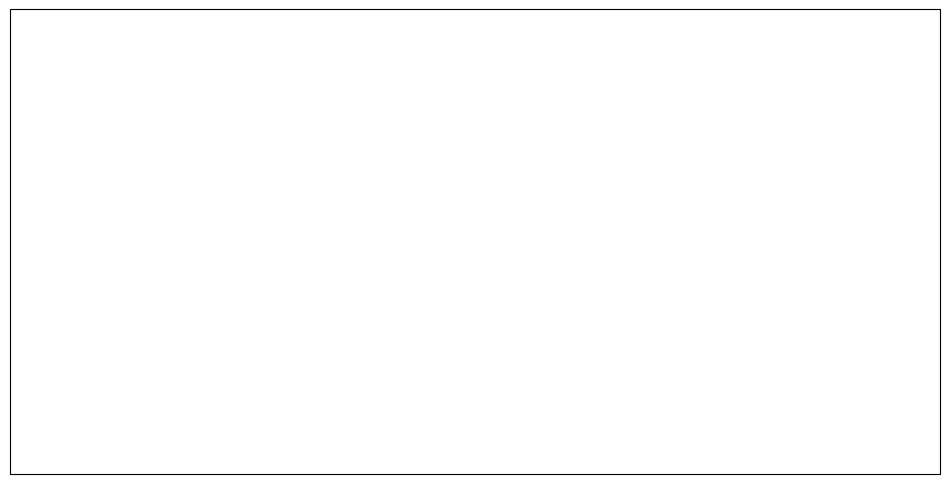

In [18]:
fig, ax = plt.subplots(figsize=(12, 8), subplot_kw=dict(projection=ccrs.PlateCarree()))
#ax.set_extent([-40.5, -40, -9.875, -11.125], crs=ccrs.PlateCarree())  # Define a extensão geográfica do mapa

# Adiciona características ao mapa
#lito_recortado.plot(ax=ax, color='grey', edgecolor='black')
lito_recortado.plot(ax=ax, column='LITOTIPOS',cmap='tab20c')

# Tamanho dos ticks (ajuste conforme necessário)
tick_length = 0.1
tick_label_fontsize = 12

# Dicionários para armazenar as menores latitudes para cada longitude e vice-versa
lowest_lat_for_lon = {}
lowest_lon_for_lat = {}

# Primeiro, determine os pontos mais baixos para cada longitude e os mais à esquerda para cada latitude
for id in gdf.iterrows():
    poly = id[1].geometry
    x, y = poly.exterior.xy

    for xi, yi in zip(x, y):
        if xi not in lowest_lat_for_lon or yi < lowest_lat_for_lon[xi]:
            lowest_lat_for_lon[xi] = yi
        if yi not in lowest_lon_for_lat or xi < lowest_lon_for_lat[yi]:
            lowest_lon_for_lat[yi] = xi

# Agora, plote os polígonos e adicione ticks onde apropriado
for id in gdf.iterrows():
    poly = id[1].geometry
    x, y = poly.exterior.xy
    plt.plot(x, y, color='black')

    for xi, yi in zip(x, y):
        if xi % 5 == 0 and yi == lowest_lat_for_lon[xi]:
            plt.plot([xi, xi], [yi, yi - tick_length], color='black')
            # Adicione N ou S para latitude dependendo do sinal de yi
            ns_label = 'E' if yi >= 0 else 'W'
            plt.text(xi, yi - 2 * tick_length, f'{abs(xi):.0f}°{ns_label}', ha='center', va='top', fontsize=tick_label_fontsize)

        if yi % 5 == 0 and xi == lowest_lon_for_lat[yi]:
            plt.plot([xi, xi - tick_length], [yi, yi], color='black')
            # Adicione E ou W para longitude dependendo do sinal de xi
            ew_label = '' if yi == 0 else ('N' if yi > 0 else 'S')
            plt.text(xi - 2 * tick_length, yi, f'{abs(yi):.0f}°{ew_label}', ha='right', va='center', fontsize=tick_label_fontsize)
                      
plt.axis('scaled')
plt.tight_layout()  # Ajusta o layout

plt.savefig('/home/ggrl/projetos/PreditorTerra/docs/images/pedaco.svg', format='svg', bbox_inches='tight')
plt.show()

In [29]:
def add_scale_bar(ax, scale_len_km, location=(0.1, 0.01), linewidth=3, fontsize=12):
    """
    Adiciona uma barra de escala ao mapa.

    Args:
    - ax: O eixo do Matplotlib onde a barra de escala será desenhada.
    - scale_len_km: O comprimento da barra de escala em quilômetros.
    - location: Uma tupla (x, y) que define a posição da barra de escala no plot.
    - linewidth: Espessura da linha da barra de escala.
    - fontsize: Tamanho da fonte do texto da barra de escala.
    """
    # Converter a localização da barra de escala para coordenadas do plot
    x, y = location
    # Desenhar a barra de escala
    ax.plot([x, x + scale_len_km / 100.0], [y, y], color='black', linewidth=linewidth, transform=ccrs.PlateCarree())
    # Adicionar texto da barra de escala
    ax.text(x + scale_len_km / 200.0, y - 0.2, f'{scale_len_km} km', verticalalignment='top', horizontalalignment='center', transform=ccrs.Geodetic(), fontsize=fontsize)

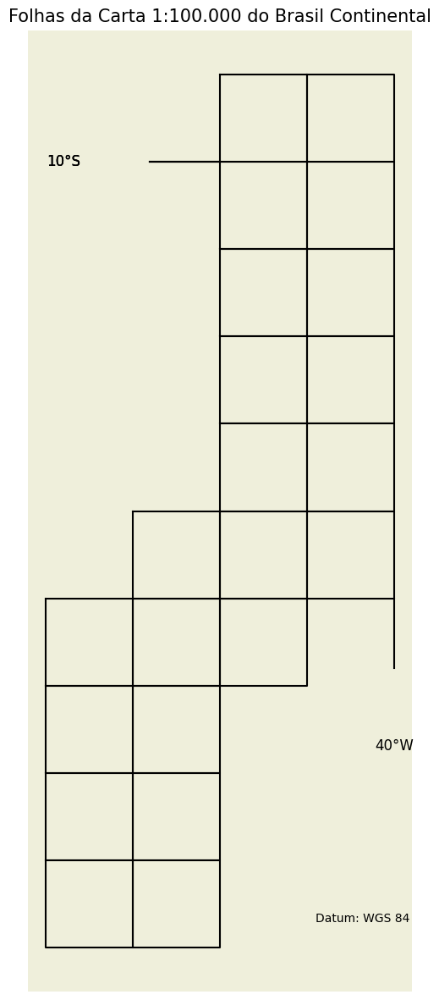

In [35]:
fig, ax = plt.subplots(figsize=(26, 12), subplot_kw=dict(projection=ccrs.PlateCarree()))
#ax.set_extent([-80, -45, -30, 5], crs=ccrs.PlateCarree())  # Define a extensão geográfica do mapa

# Adiciona características ao mapa
ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS, linestyle=':')

# Tamanho dos ticks (ajuste conforme necessário)
tick_length = 0.1
tick_label_fontsize = 12

# Dicionários para armazenar as menores latitudes para cada longitude e vice-versa
lowest_lat_for_lon = {}
lowest_lon_for_lat = {}

# Primeiro, determine os pontos mais baixos para cada longitude e os mais à esquerda para cada latitude
for id in list(quadricula.keys()):
    carta = quadricula[id]
    poly = carta['folha']['geometry']
    x, y = poly.exterior.xy

    for xi, yi in zip(x, y):
        if xi not in lowest_lat_for_lon or yi < lowest_lat_for_lon[xi]:
            lowest_lat_for_lon[xi] = yi
        if yi not in lowest_lon_for_lat or xi < lowest_lon_for_lat[yi]:
            lowest_lon_for_lat[yi] = xi

# Agora, plote os polígonos e adicione ticks onde apropriado
for id in list(quadricula.keys()):
    carta = quadricula[id]
    poly = carta['folha']['geometry']
    x, y = poly.exterior.xy
    plt.plot(x, y, color='black')

    for xi, yi in zip(x, y):
        if xi % 5 == 0 and yi == lowest_lat_for_lon[xi]:
            plt.plot([xi, xi], [yi, yi - tick_length], color='black')
            # Adicione N ou S para latitude dependendo do sinal de yi
            ns_label = 'E' if yi >= 0 else 'W'
            plt.text(xi, yi - 2 * tick_length, f'{abs(xi):.0f}°{ns_label}', ha='center', va='top', fontsize=tick_label_fontsize)

        if yi % 5 == 0 and xi == lowest_lon_for_lat[yi]:
            plt.plot([xi, xi - tick_length], [yi, yi], color='black')
            # Adicione E ou W para longitude dependendo do sinal de xi
            ew_label = '' if yi == 0 else ('N' if yi > 0 else 'S')
            plt.text(xi - 2 * tick_length, yi, f'{abs(yi):.0f}°{ew_label}', ha='right', va='center', fontsize=tick_label_fontsize)
                      
plt.suptitle('Folhas da Carta 1:100.000 do Brasil Continental',fontsize=15)
plt.axis('off')  # Desativa os eixos para remover a moldura padrão
plt.axis('scaled')
plt.tight_layout()  # Ajusta o layout

#x_pos, y_pos = -37, 5  # Posição inicial da seta no mapa
#ax.annotate('N', xy=(x_pos, y_pos), xycoords='data', xytext=(0, -60), textcoords='offset points',
#            arrowprops=dict(arrowstyle="->", color='black'), ha='center', fontsize=20, color='black')

#add_scale_bar(ax, 500, location=(-43.5, -34), linewidth=5, fontsize=12,)  # Exemplo de 500 km
plt.text(0.75, 0.07, 'Datum: WGS 84',
         transform=plt.gca().transAxes,
         fontsize=10,
         verticalalignment='bottom',
         horizontalalignment='left')
plt.savefig('/home/ggrl/projetos/PreditorTerra/docs/images/100k_brasilcont.svg', format='svg', bbox_inches='tight')
plt.show()

In [36]:
len(quadricula)

22

In [37]:
#quadricula = Build_mc(escala='50k',ID=['SF23_YB','SF23_YA','SF23_VC','SF23_VD'],verbose=True)

In [24]:
quadricula

{'SC23_YB_VI4_SE': {'folha': EPSG                                                         32723
  geometry         POLYGON ((-45.125 -10.875, -45 -10.875, -45 -1...
  geometry_proj    POLYGON ((486338.7883517565 8797839.007003773,...
  Name: SC23_YB_VI4_SE, dtype: object},
 'SC23_ZA_IV3_SW': {'folha': EPSG                                                         32723
  geometry         POLYGON ((-45 -10.875, -44.875 -10.875, -44.87...
  geometry_proj    POLYGON ((500000 8797841.818535438, 513661.211...
  Name: SC23_ZA_IV3_SW, dtype: object},
 'SC23_ZA_IV3_SE': {'folha': EPSG                                                         32723
  geometry         POLYGON ((-44.875 -10.875, -44.75 -10.875, -44...
  geometry_proj    POLYGON ((513661.2116482435 8797839.007003773,...
  Name: SC23_ZA_IV3_SE, dtype: object},
 'SC23_ZA_IV4_SW': {'folha': EPSG                                                         32723
  geometry         POLYGON ((-44.75 -10.875, -44.625 -10.875, -44...
  geometry_pr

# Adicionando dados brutos à Quadrícula

In [39]:
list_geof

['mag_line_1105',
 'mag_1039',
 'gama_line_1105',
 'mag_line_1089',
 'gama_1039',
 'mag_3022',
 'mag_1105',
 'mag_tie_1105',
 'gama_1039_mdt.csv',
 'gama_line_1089',
 'gama_3022',
 'gama_line_1092',
 'geof_1039']

In [49]:
quadricula['SC24_VD_IV4_SE']['gama_line_1089']

,X,Y,LATITUDE,LONGITUDE,CTCOR,eU,eTh,KPERC,UTHRAZAO,THKRAZAO,UKRAZAO,MDT
0,472115.74,8754877.13,-11.263461,-45.255477,571.35,1.04,7.43,0.05,0.1398,159.5634,22.3105,776.89
1,472115.90,8754953.80,-11.262768,-45.255475,596.58,1.08,7.53,0.10,0.1440,76.7952,11.0589,775.02
2,472116.15,8755030.53,-11.262074,-45.255472,631.86,1.18,7.75,0.13,0.1520,61.2704,9.3150,773.50
3,472116.27,8755107.38,-11.261379,-45.255470,643.86,1.16,8.06,0.12,0.1458,67.8138,9.8877,771.65
4,472115.89,8755184.41,-11.260682,-45.255473,710.77,1.08,9.44,0.12,0.1134,80.5041,9.1303,769.55
...,...,...,...,...,...,...,...,...,...,...,...,...
635168,665126.58,8782417.52,-11.010735,-43.488568,562.15,0.59,7.02,0.29,0.0833,23.8827,1.9898,422.06
635169,665130.89,8782340.24,-11.011434,-43.488525,588.93,0.61,7.26,0.33,0.0858,22.3755,1.9209,422.94
635170,665135.62,8782262.93,-11.012132,-43.488478,630.33,0.66,7.69,0.36,0.0843,21.1524,1.7839,423.37
635171,665140.29,8782185.57,-11.012832,-43.488431,599.77,0.48,7.39,0.40,0.0661,18.7542,1.2390,422.44


In [25]:
#gama_3022,mag_3022=Upload_geof(quadricula,'gama_3022','mag_3022',1100)
#gama_1105,mag_1105=Upload_geof(quadricula,'gama_line_1105','mag_line_1105',1100)
#gama_1039,mag_1039=Upload_geof(quadricula,'gama_1039','mag_1039',1100)
gama_1089,mag_1089=Upload_geof(quadricula,'gama_line_1089','mag_line_1089',500)

 13%|█████▍                                   | 2/15 [00:00<00:01, 11.80it/s]

 - gama_line_1089 atualizado na folha: SC23_YB_VI4_SE com 103060 pontos
 - mag_line_1089 atualizado na folha: SC23_YB_VI4_SE com 1028341 pontos
 - gama_line_1089 atualizado na folha: SC23_ZA_IV3_SW com 87889 pontos
 - mag_line_1089 atualizado na folha: SC23_ZA_IV3_SW com 876804 pontos
 - gama_line_1089 atualizado na folha: SC23_ZA_IV3_SE com 72310 pontos


 27%|██████████▉                              | 4/15 [00:00<00:00, 13.24it/s]

 - mag_line_1089 atualizado na folha: SC23_ZA_IV3_SE com 721231 pontos
 - gama_line_1089 atualizado na folha: SC23_ZA_IV4_SW com 57305 pontos
 - mag_line_1089 atualizado na folha: SC23_ZA_IV4_SW com 571359 pontos
 - gama_line_1089 atualizado na folha: SC23_ZA_IV3_NW com 146485 pontos
 - mag_line_1089 atualizado na folha: SC23_ZA_IV3_NW com 1462805 pontos
 - gama_line_1089 atualizado na folha: SC23_ZA_IV3_NE com 125930 pontos


 53%|█████████████████████▊                   | 8/15 [00:00<00:00, 13.00it/s]

 - mag_line_1089 atualizado na folha: SC23_ZA_IV3_NE com 1257489 pontos
 - gama_line_1089 atualizado na folha: SC23_ZA_IV4_NW com 106157 pontos
 - mag_line_1089 atualizado na folha: SC23_ZA_IV4_NW com 1059895 pontos
 - gama_line_1089 atualizado na folha: SC23_ZA_IV4_NE com 95283 pontos
 - mag_line_1089 atualizado na folha: SC23_ZA_IV4_NE com 951302 pontos
 - gama_line_1089 atualizado na folha: SC23_ZA_V3_NW com 84738 pontos


 67%|██████████████████████████▋             | 10/15 [00:00<00:00, 12.64it/s]

 - mag_line_1089 atualizado na folha: SC23_ZA_V3_NW com 845994 pontos
 - gama_line_1089 atualizado na folha: SC23_ZA_IV1_SE com 179879 pontos
 - mag_line_1089 atualizado na folha: SC23_ZA_IV1_SE com 1796996 pontos
 - gama_line_1089 atualizado na folha: SC23_ZA_IV2_SW com 155345 pontos
 - mag_line_1089 atualizado na folha: SC23_ZA_IV2_SW com 1551736 pontos
 - gama_line_1089 atualizado na folha: SC23_ZA_IV2_SE com 139745 pontos


 93%|█████████████████████████████████████▎  | 14/15 [00:01<00:00, 11.81it/s]

 - mag_line_1089 atualizado na folha: SC23_ZA_IV2_SE com 1395864 pontos
 - gama_line_1089 atualizado na folha: SC23_ZA_IV2_NW com 204394 pontos
 - mag_line_1089 atualizado na folha: SC23_ZA_IV2_NW com 2042319 pontos
 - gama_line_1089 atualizado na folha: SC23_ZA_IV2_NE com 184088 pontos
 - mag_line_1089 atualizado na folha: SC23_ZA_IV2_NE com 1839342 pontos
 - gama_line_1089 atualizado na folha: SC23_ZA_V1_NW com 163769 pontos


100%|████████████████████████████████████████| 15/15 [00:01<00:00, 12.20it/s]

 - mag_line_1089 atualizado na folha: SC23_ZA_V1_NW com 1636276 pontos


TypeError: cannot unpack non-iterable NoneType object

In [ ]:
geof_list_ids = list(quadricula.keys())

print(len(geof_list_ids))

for id in geof_list_ids:
    print(f' - Folha: {id}')
    carta=quadricula[id]
    for data in list(carta.keys())[2:]:
        print(f'    - {data}')

In [ ]:
columns = list(quadricula[id].keys())
len(quadricula[id][columns[2]])

In [ ]:
quadricula=pop_nodata(quadricula)
len(quadricula.keys())

In [26]:
for id in list(quadricula.keys()):
    
    print(f' - Folha:  {id}')
    carta = quadricula[id]
    print(f'    - {list(carta.keys())}')

 - Folha:  SC23_YB_VI4_SE
    - ['folha', 'region_utm', 'gama_line_1089', 'mag_line_1089']
 - Folha:  SC23_ZA_IV3_SW
    - ['folha', 'region_utm', 'gama_line_1089', 'mag_line_1089']
 - Folha:  SC23_ZA_IV3_SE
    - ['folha', 'region_utm', 'gama_line_1089', 'mag_line_1089']
 - Folha:  SC23_ZA_IV4_SW
    - ['folha', 'region_utm', 'gama_line_1089', 'mag_line_1089']
 - Folha:  SC23_ZA_IV3_NW
    - ['folha', 'region_utm', 'gama_line_1089', 'mag_line_1089']
 - Folha:  SC23_ZA_IV3_NE
    - ['folha', 'region_utm', 'gama_line_1089', 'mag_line_1089']
 - Folha:  SC23_ZA_IV4_NW
    - ['folha', 'region_utm', 'gama_line_1089', 'mag_line_1089']
 - Folha:  SC23_ZA_IV4_NE
    - ['folha', 'region_utm', 'gama_line_1089', 'mag_line_1089']
 - Folha:  SC23_ZA_V3_NW
    - ['folha', 'region_utm', 'gama_line_1089', 'mag_line_1089']
 - Folha:  SC23_ZA_IV1_SE
    - ['folha', 'region_utm', 'gama_line_1089', 'mag_line_1089']
 - Folha:  SC23_ZA_IV2_SW
    - ['folha', 'region_utm', 'gama_line_1089', 'mag_line_1089']


In [27]:
#len(quadricula['SF23_YA_V4']['gama_1039'])

## Vizualisando Área de Estudo

SC23_YB_VI4_SE
SC23_ZA_IV3_SW
SC23_ZA_IV3_SE
SC23_ZA_IV4_SW
SC23_ZA_IV3_NW
SC23_ZA_IV3_NE
SC23_ZA_IV4_NW
SC23_ZA_IV4_NE
SC23_ZA_V3_NW
SC23_ZA_IV1_SE
SC23_ZA_IV2_SW
SC23_ZA_IV2_SE
SC23_ZA_IV2_NW
SC23_ZA_IV2_NE
SC23_ZA_V1_NW


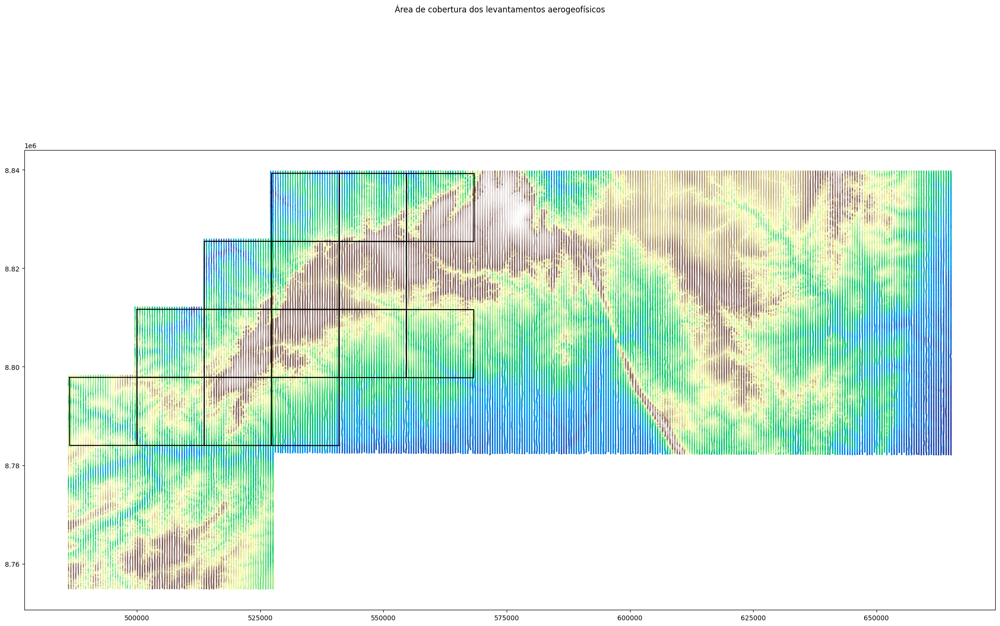

In [28]:
plt.figure(figsize=(21,16))
for id in list(quadricula.keys()):
    print(id)
    carta=quadricula[id]
    folha_utm=transform_to_carta_utm(carta['folha'])
    plt.plot(*folha_utm.exterior.xy,color='black')
    #plt.annotate(str(id),xy=folha_utm.centroid.coords[0],textcoords=folha_utm.centroid.coords[0])
    for data in list(carta.keys())[2:]:
        if 'mag' in data:
            pass
        else:
            plt.scatter(carta[data].X,carta[data].Y,c=carta[data].MDT,cmap='terrain',s=0.5,marker='H')
            plt.axis('scaled')
plt.suptitle('Área de cobertura dos levantamentos aerogeofísicos')
plt.tight_layout()

## Visualizando dados Radiométricos Brutos

In [ ]:
plot_histograms(gama_3022)

In [ ]:
plot_raw_gama_data(gama_3022,suptitle='Dados Radiométricos brutos (Gama_3022.XYZ)')

In [ ]:
plot_boxplots(gama_1105,gama_FEAT)

In [ ]:
plot_histograms(gama_1105)

In [ ]:
plot_raw_gama_data(gama_1105,suptitle='DADOS AEROGAMAESPECTROMÉTRICO')

In [ ]:
gama_1039.rename(columns={'CTC':'CTCOR','KC':'KPERC','UC':'eU','THC':'eTh'},inplace=True)


In [ ]:
gama_1039_positive=remove_negative_values(gama_1039,lista=['X','Y','LATITUDE','LONGITUDE','geometry'])

gama_1039_positive['UTHRAZAO']=gama_1039_positive['eU']/gama_1039_positive['eTh']
gama_1039_positive['UKRAZAO']=gama_1039_positive['eU']/gama_1039_positive['KPERC']
gama_1039_positive['THKRAZAO']=gama_1039_positive['eTh']/gama_1039_positive['KPERC']

In [ ]:
plot_boxplots(gama_1039,gama_FEAT)

In [ ]:
plot_histograms(gama_1039)

In [ ]:
plot_histograms(gama_1039_positive)

In [ ]:
plot_raw_gama_data(gama_1039,suptitle='Dados Radiométricos brutos (XYZ)',orientation='vertical')

## Removendo valores negativos das contagens radiométricas

In [25]:
gama_3022_positive = remove_negative_values(gama_3022)

Atributo - CTCOR
Atributo - eTh
Atributo - eU
Atributo - KPERC
Atributo - MDT
Atributo - THKRAZAO
Atributo - UKRAZAO
Atributo - UTHRAZAO


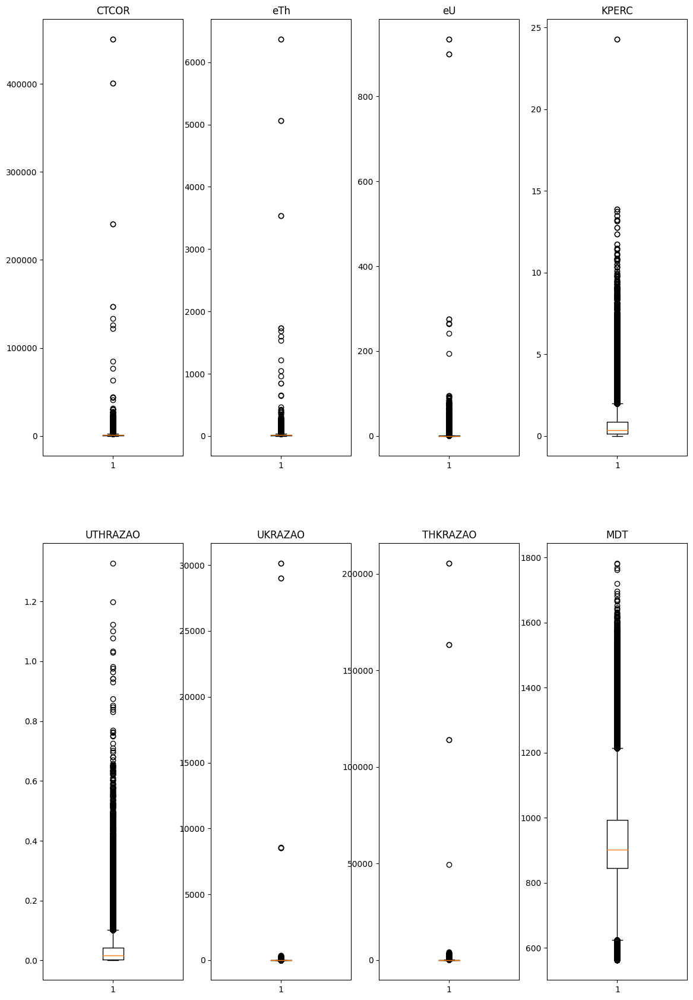

In [26]:
plot_boxplots(gama_3022_positive,gama_FEAT)

             count         mean          std      min       0.1%        1%   
CTCOR     525310.0  1273.519179  1717.829015    0.001    0.00100    0.0010  \
eTh       525310.0    16.685630    22.941761    0.001    0.00100    0.6000   
eU        525310.0     0.548357     3.201134    0.001    0.00100    0.0010   
KPERC     525310.0     0.676153     0.860617    0.001    0.00100    0.0010   
MDT       525310.0   937.394729   144.556802  562.040  578.53309  658.3936   
THKRAZAO  525310.0   106.517030   593.296064    0.155    0.78800    2.2970   
UTHRAZAO  525310.0     0.029394     0.038242    0.001    0.00100    0.0010   
UKRAZAO   525310.0     2.911118    84.418047    0.002    0.00400    0.0060   

                5%      25%       50%        75%        99.95%         max  
CTCOR     340.8245  719.060  1066.715  1495.9900  14986.650000  450895.020  
eTh         4.3000    9.000    13.600    19.7000    180.600000    6371.400  
eU          0.0010    0.001     0.200     0.6000     32.069100    

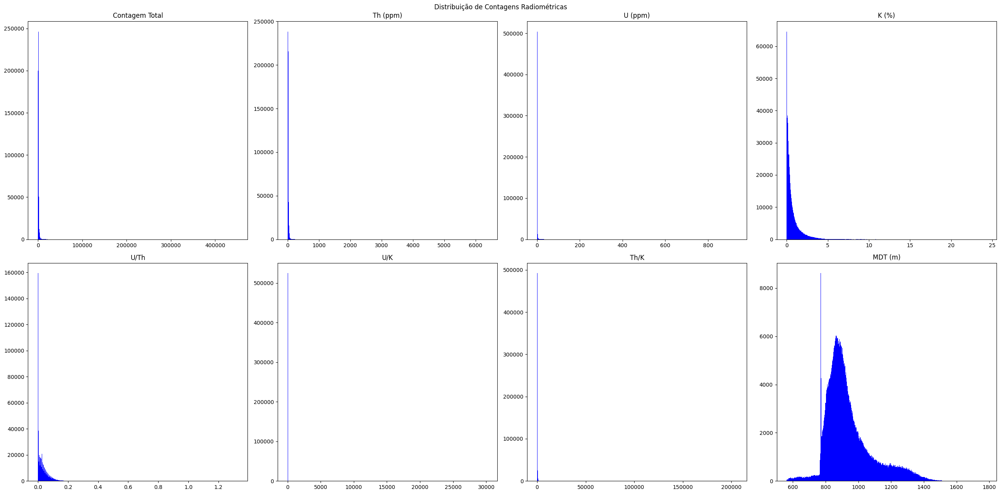

In [27]:
plot_histograms(gama_3022_positive)

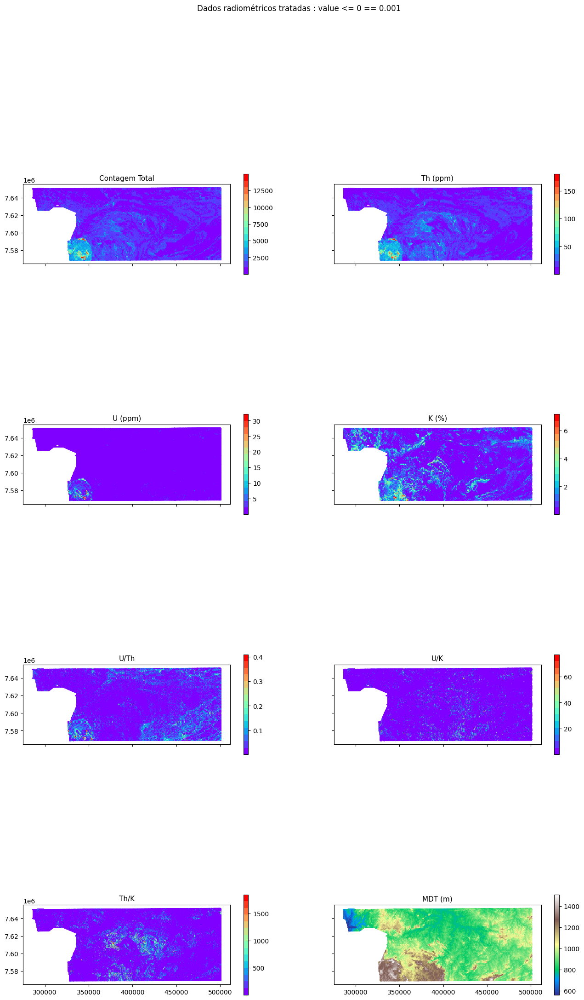

In [28]:
plot_raw_gama_data(gama_3022_positive,'Dados radiométricos tratadas : value <= 0 == 0.001')

In [29]:
gama_1105_positive = remove_negative_values(gama_1105)

Atributo - KPERC
Atributo - eU
Atributo - eTh
Atributo - UTHRAZAO
Atributo - UKRAZAO
Atributo - MDT
Atributo - THKRAZAO
Atributo - CTCOR


             count         mean         std      min        0.1%         1%   
CTCOR     634436.0    10.984530    9.034912    0.001    1.047000    2.41635  \
eTh       634436.0    18.916906    9.478910    0.001    2.199000    4.75000   
eU        634436.0     1.649881    1.005950    0.001    0.001000    0.00100   
KPERC     634436.0     0.911423    0.712131    0.001    0.001000    0.00100   
MDT       634436.0  1042.974653  289.630767  513.280  521.130000  532.14350   
THKRAZAO  634436.0    31.907327   29.382652    1.079    2.655435    4.98135   
UTHRAZAO  634436.0     0.095022    0.042958    0.001    0.001000    0.02100   
UKRAZAO   634436.0     2.808605    2.579272    0.046    0.161000    0.30000   

               5%      25%      50%       75%       99.95%       max  
CTCOR       3.510    5.778    8.235    12.591   103.678250   246.600  
eTh         7.186   12.131   17.384    23.765    85.542900   223.136  
eU          0.320    0.977    1.518     2.155     9.460000    23.934  
KPER

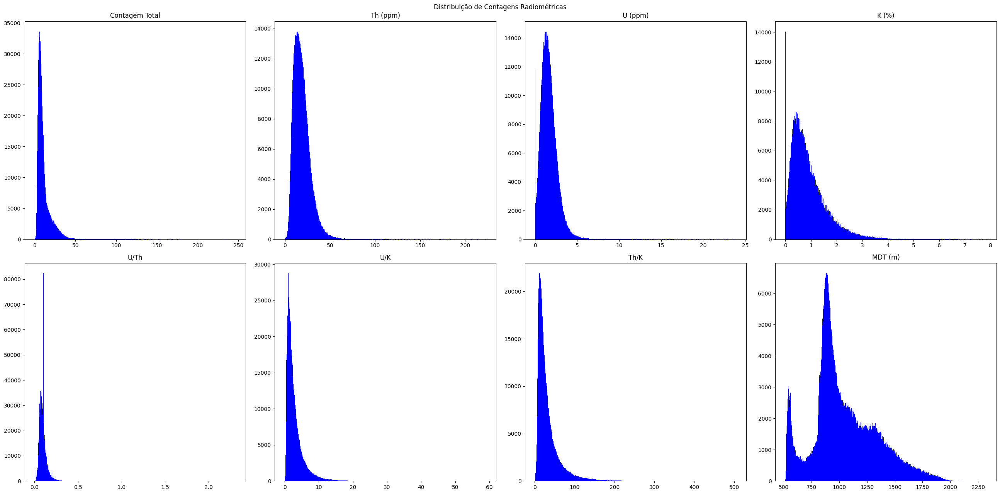

In [30]:
plot_histograms(gama_1105_positive)

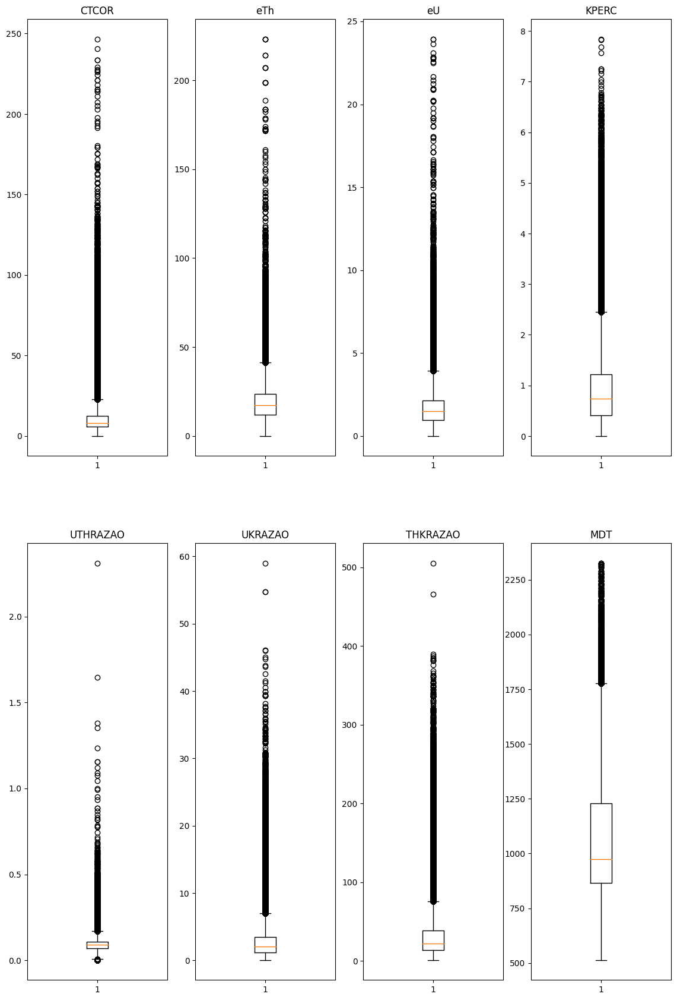

In [31]:
plot_boxplots(gama_1105_positive,gama_FEAT)

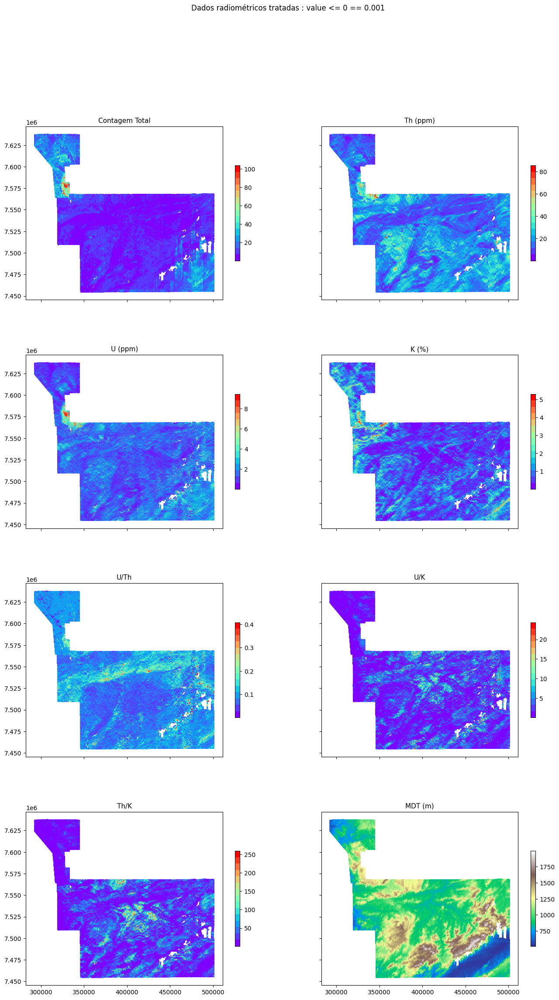

In [32]:
plot_raw_gama_data(gama_1105_positive,'Dados radiométricos tratadas : value <= 0 == 0.001')

             count         mean          std         min        0.1%   
CTCOR     136171.0  1217.949255   695.287355    0.001000   84.408400  \
eTh       136171.0    65.590583    42.358837    0.001000    0.001000   
eU        136171.0    16.948117    11.460870    0.001000    0.001000   
KPERC     136171.0    59.925998    64.414913    0.001000    0.001000   
MDT       136171.0   685.486466   118.314475  494.500000  503.537669   
THKRAZAO  136171.0   998.951773  7051.884789    0.000005    0.001675   
UTHRAZAO  136171.0     8.633204   337.152505    0.000002    0.000005   
UKRAZAO   136171.0   432.079279  3132.728481    0.000002    0.000004   

                  1%          5%         25%          50%          75%   
CTCOR     300.397000  469.025000  736.690000  1025.230000  1518.265000  \
eTh         9.757000   19.610000   36.190000    54.200000    83.620000   
eU          0.001000    0.001000    8.820000    15.580000    23.300000   
KPERC       0.001000    3.895000   18.590000    35.9400

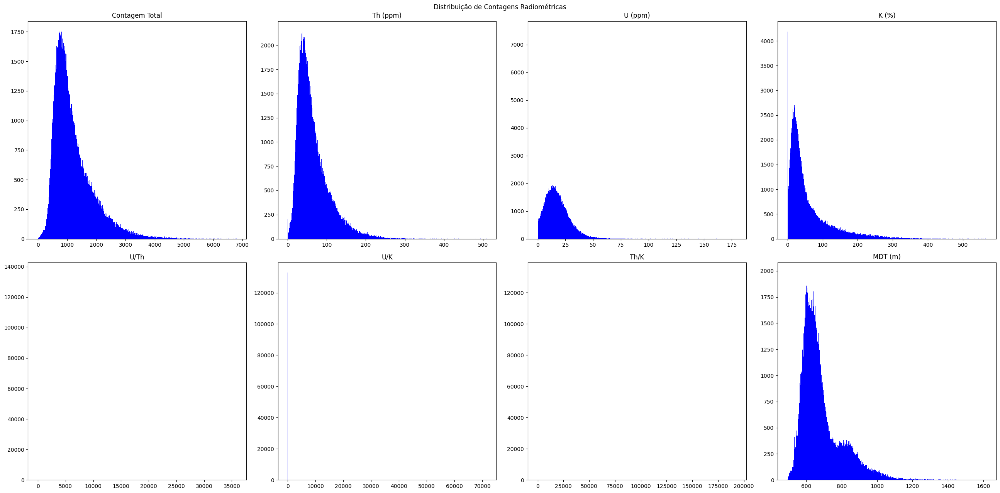

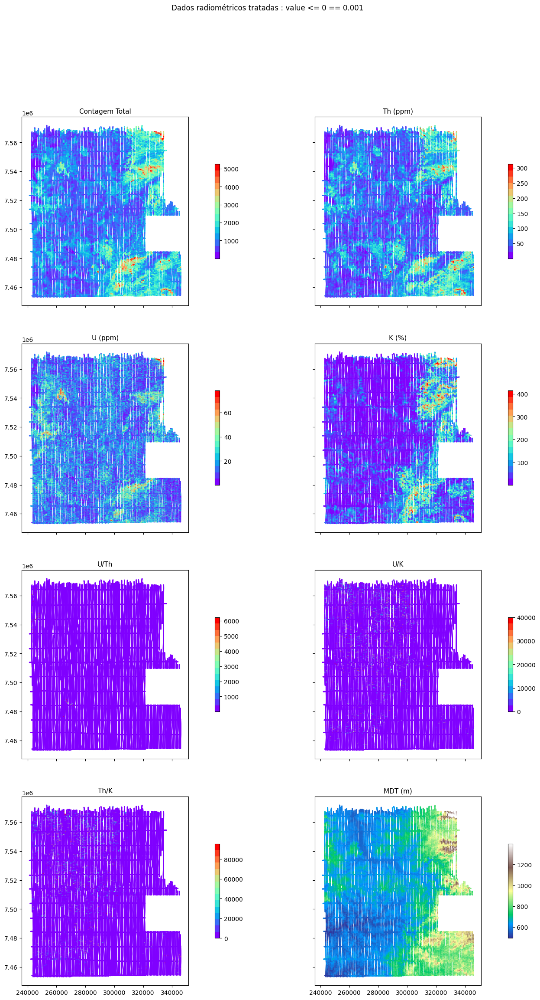

In [33]:
plot_histograms(gama_1039_positive)
plot_raw_gama_data(gama_1039_positive,'Dados radiométricos tratadas : value <= 0 == 0.001')

## CONSTRUINDO UM GRID SINTÉTICO

In [ ]:
# REMOVING PART OF THE SINTETIC GRID
'''
df_xu_yu = pd.DataFrame(np.array([xu,yu]))
df_xu_yu=df_xu_yu.T
df_xu_yu.rename(columns={0:'xu',1:'yu'},inplace=True)

df_xu_yu[(df_xu_yu.xu < 540937) & (df_xu_yu.yu > 8866937)]

df_xu_yu.drop(df_xu_yu[(df_xu_yu.xu < 540937) & (df_xu_yu.yu > 8866937)].index,inplace=True)
plt.figure(figsize=(18,12))

plt.scatter(df_xu_yu.xu,df_xu_yu.yu,s=0.1,marker='.')
plt.axis('scaled')
'''

# Interpolação dos dados Brutos

## Método Cúbico

In [ ]:
# Test de área

# area=(344093.45426573796, 396417.36691108724, 7621768.799495494, 7677527.304557458)
# int((area[3]-area[2])/100),int((area[1]-area[0])/100)

In [ ]:
#traditional_interpolation(quadricula,'mag_3022','gama_3022','cubic','geof_3022')

In [ ]:
#list(quadricula['SF23_VC'].keys())

In [ ]:

#df = quadricula['SF23_VC']['geof_3022_cubic']
#plt.figure(figsize=(12,12))
#plt.scatter(x=df.X,y=df.Y,c=df.GMT,cmap='rainbow')
#plt.axis('scaled')

In [ ]:
# Print the output. a=

#descript_cubic = df.describe(percentiles)
#descript_cubic[['eU','eTh','KPERC','CTCOR','UTHRAZAO','THKRAZAO','UKRAZAO']].T

In [ ]:
#plot_histograms(geof_1089_cubic,suptitle='Distribuição dos dados radiométricos interpolados (cúbico, pixel 100m)')
#plot_raw_data(geof_1089_cubic,suptitle='Dados radiométricos interpolados (cúbico, pixel 100m)')

## Método Nearest

In [ ]:
#plot_histograms(geof_1089_nearest,suptitle='Distribuição dos dados radiométricos interpolados (nearest, pixel 100m)')

In [ ]:
#plot_raw_data(geof_1089_nearest,suptitle='Dados radiométricos interpolados (nearest, pixel 100m)')

## Método Linear

In [34]:
traditional_interpolation(quadricula,'mag_3022','gama_3022','linear','geof_3022')

 - Folha: SF23_VC_III3
Atributo - ALTURA
Atributo - MAGIGRF
Atributo - MDT
Atributo - CTCOR
Atributo - eTh
Atributo - eU
Atributo - KPERC
Atributo - MDT
Atributo - THKRAZAO
Atributo - UKRAZAO
Atributo - UTHRAZAO
Index(['ALTURA', 'LATITUDE', 'LONGITUDE', 'MAGIGRF', 'MDT', 'X', 'Y'], dtype='object')
 - Folha: SF23_VC_III4
Atributo - ALTURA
Atributo - MAGIGRF
Atributo - MDT
Atributo - CTCOR
Atributo - eTh
Atributo - eU
Atributo - KPERC
Atributo - MDT
Atributo - THKRAZAO
Atributo - UKRAZAO
Atributo - UTHRAZAO
Index(['ALTURA', 'LATITUDE', 'LONGITUDE', 'MAGIGRF', 'MDT', 'X', 'Y'], dtype='object')
 - Folha: SF23_VC_VI2
Atributo - ALTURA
Atributo - MAGIGRF
Atributo - MDT
Atributo - CTCOR
Atributo - eTh
Atributo - eU
Atributo - KPERC
Atributo - MDT
Atributo - THKRAZAO
Atributo - UKRAZAO
Atributo - UTHRAZAO
Index(['ALTURA', 'LATITUDE', 'LONGITUDE', 'MAGIGRF', 'MDT', 'X', 'Y'], dtype='object')
 - Folha: SF23_VC_VI4
Atributo - ALTURA
Atributo - MAGIGRF
Atributo - MDT
Atributo - CTCOR
Atributo - eT

In [35]:
traditional_interpolation(quadricula,'mag_line_1105','gama_line_1105','linear','geof_1105')

 - Folha: SF23_YB_I1
Atributo - ALTURA
Atributo - MDT
Atributo - ALTURA_1
Atributo - MAGIGRF
Atributo - KPERC
Atributo - eU
Atributo - eTh
Atributo - UTHRAZAO
Atributo - UKRAZAO
Atributo - MDT
Atributo - THKRAZAO
Atributo - CTCOR
Index(['ALTURA', 'X', 'Y', 'MDT', 'LATITUDE', 'LONGITUDE', 'ALTURA_1',
       'MAGIGRF'],
      dtype='object')
 - Folha: SF23_YB_I3
Atributo - ALTURA
Atributo - MDT
Atributo - ALTURA_1
Atributo - MAGIGRF
Atributo - KPERC
Atributo - eU
Atributo - eTh
Atributo - UTHRAZAO
Atributo - UKRAZAO
Atributo - MDT
Atributo - THKRAZAO
Atributo - CTCOR
Index(['ALTURA', 'X', 'Y', 'MDT', 'LATITUDE', 'LONGITUDE', 'ALTURA_1',
       'MAGIGRF'],
      dtype='object')
 - Folha: SF23_YB_IV1
Atributo - ALTURA
Atributo - MDT
Atributo - ALTURA_1
Atributo - MAGIGRF
Atributo - KPERC
Atributo - eU
Atributo - eTh
Atributo - UTHRAZAO
Atributo - UKRAZAO
Atributo - MDT
Atributo - THKRAZAO
Atributo - CTCOR
Index(['ALTURA', 'X', 'Y', 'MDT', 'LATITUDE', 'LONGITUDE', 'ALTURA_1',
       'MAGIGR

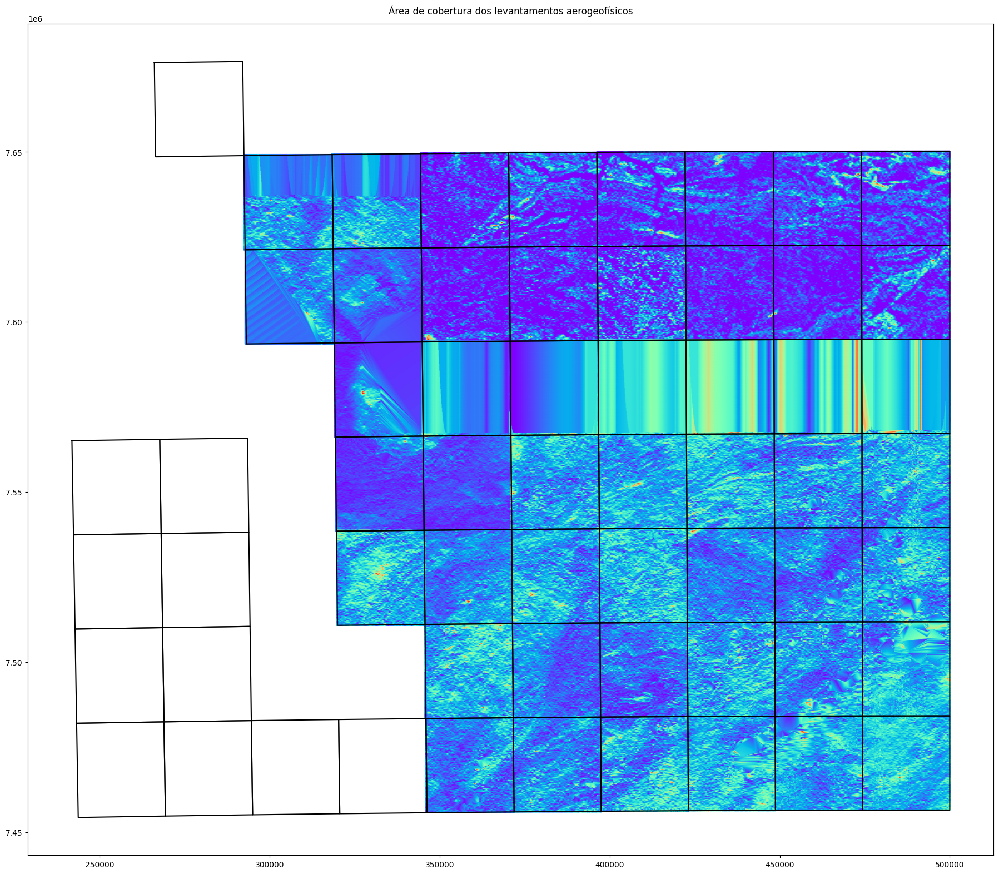

In [36]:
plt.figure(figsize=(24,16))

# PLOTANDO A MALHA CARTOGRÁFICA
for id in list(quadricula.keys()):
    carta=quadricula[id]
    plt.plot(*transform_to_carta_utm(carta['folha']).exterior.xy,color='black')
    
    # PLOTANDO OS DADOS INTERPOLADOS
    for data in list(carta.keys())[2:]:        
        if 'geof' in data:
            plt.scatter(carta[data].X,carta[data].Y,c=carta[data].eU,cmap='rainbow',s=0.5,marker='H')
            plt.axis('scaled')
        # SE NÃO TIVER DADOS NÃO PLOTA NADA
        else:
            pass
        
plt.suptitle('Área de cobertura dos levantamentos aerogeofísicos')
plt.tight_layout()

In [38]:
traditional_interpolation(quadricula,'mag_1039','gama_1039','linear','geof_1039')

 - Folha: SF23_YA_II1
Atributo - MDT
Atributo - MAGR
Atributo - THC
Atributo - UC
Atributo - KC
Atributo - CTC
Atributo - MDT
Index(['X', 'Y', 'LONGITUDE', 'LATITUDE', 'MDT', 'MAGIGRF'], dtype='object')
 - Folha: SF23_YA_II3
Atributo - MDT
Atributo - MAGR
Atributo - THC
Atributo - UC
Atributo - KC
Atributo - CTC
Atributo - MDT
Index(['X', 'Y', 'LONGITUDE', 'LATITUDE', 'MDT', 'MAGIGRF'], dtype='object')
 - Folha: SF23_YA_V1
Atributo - MDT
Atributo - MAGR
Atributo - THC
Atributo - UC
Atributo - KC
Atributo - CTC
Atributo - MDT
Index(['X', 'Y', 'LONGITUDE', 'LATITUDE', 'MDT', 'MAGIGRF'], dtype='object')
 - Folha: SF23_YA_V3
Atributo - MDT
Atributo - MAGR
Atributo - THC
Atributo - UC
Atributo - KC
Atributo - CTC
Atributo - MDT
Index(['X', 'Y', 'LONGITUDE', 'LATITUDE', 'MDT', 'MAGIGRF'], dtype='object')
 - Folha: SF23_YA_II2
Atributo - MDT
Atributo - MAGR
Atributo - THC
Atributo - UC
Atributo - KC
Atributo - CTC
Atributo - MDT
Index(['X', 'Y', 'LONGITUDE', 'LATITUDE', 'MDT', 'MAGIGRF'], dty

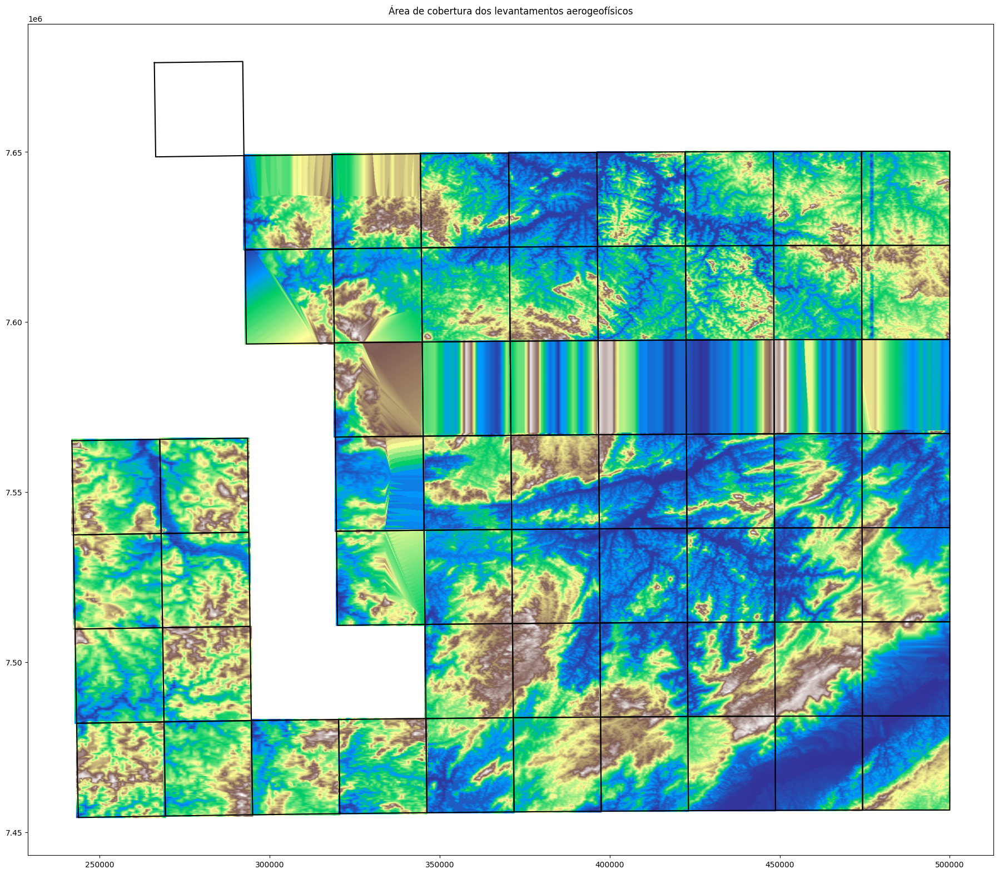

In [39]:
plt.figure(figsize=(24,16))

for id in list(quadricula.keys()):
    carta=quadricula[id]
    plt.plot(*transform_to_carta_utm(carta['folha']).exterior.xy,color='black')
    
    for data in list(carta.keys())[2:]:
        if 'geof' in data:
            plt.scatter(carta[data].X,carta[data].Y,c=carta[data].MDT,cmap='terrain',s=0.5,marker='H')
            plt.axis('scaled')
        else:
            pass
        
plt.suptitle('Área de cobertura dos levantamentos aerogeofísicos')
plt.tight_layout()


# Classificações Não-Supervisionadas

## Self-organizing maps (SOM)

In [40]:
import matplotlib
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn_som.som import SOM

def plot_corr(dataframe, size=10):
    plt.figure(figsize = (size+size*0.2, size), facecolor='w')
    corrMatrix = dataframe.corr()
    sns.heatmap(np.round(corrMatrix,2), annot=True)
    plt.xticks(rotation=90, ha='right')
    plt.yticks(rotation=0, ha='right')


### SF23_YA_III2

            count         mean         std         min        0.1%   
CTCOR     72540.0    10.638862    5.618974    1.182279    2.467299  \
eTh       72540.0    23.650289   10.158650    3.002149    5.504152   
eU        72540.0     1.972517    1.214947    0.001000    0.041367   
KPERC     72540.0     1.584911    0.989897    0.001000    0.017541   
MDT       72540.0  1020.039836  169.907884  765.115344  777.458619   
THKRAZAO  72540.0    23.091371   20.593088    2.848998    3.232426   
UTHRAZAO  72540.0     0.085738    0.029095    0.001000    0.017097   
UKRAZAO   72540.0     1.912889    1.693197    0.076108    0.148513   

                  1%          5%         25%         50%          75%   
CTCOR       3.395509    4.769986    7.394854    9.506086    12.413033  \
eTh         7.803473   11.097638   16.381003   21.654381    28.772409   
eU          0.248314    0.585850    1.195337    1.713486     2.446279   
KPERC       0.133043    0.334360    0.797496    1.362108     2.249035   
MDT 

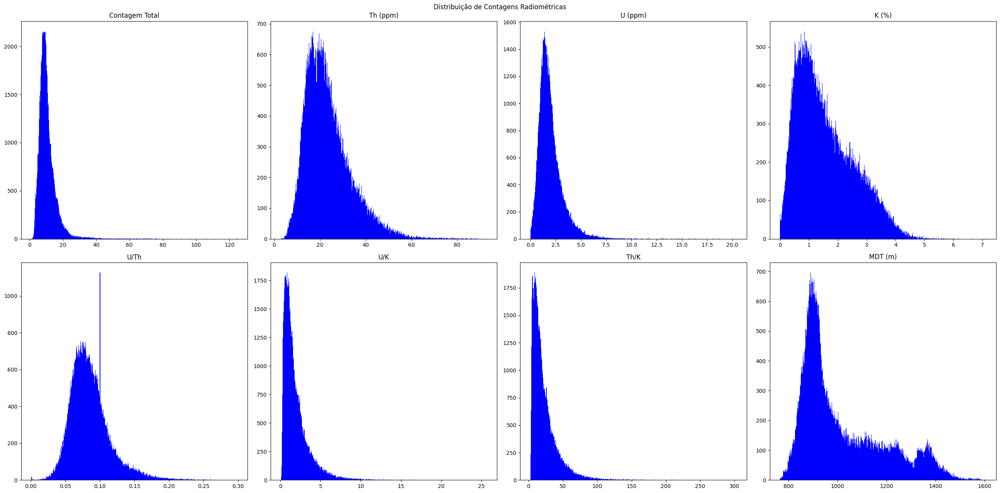

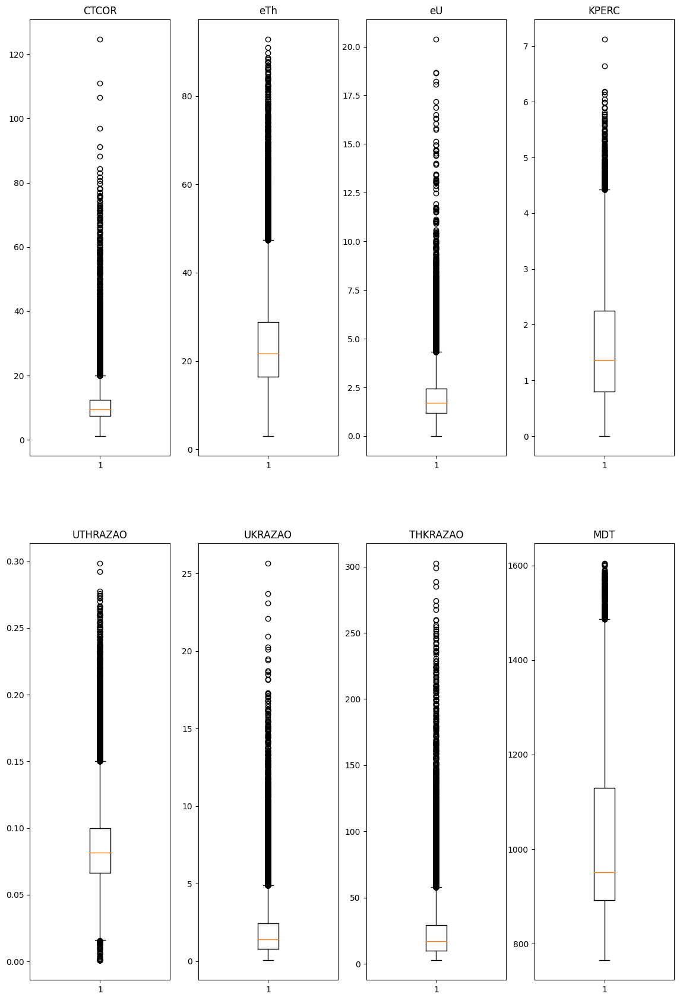

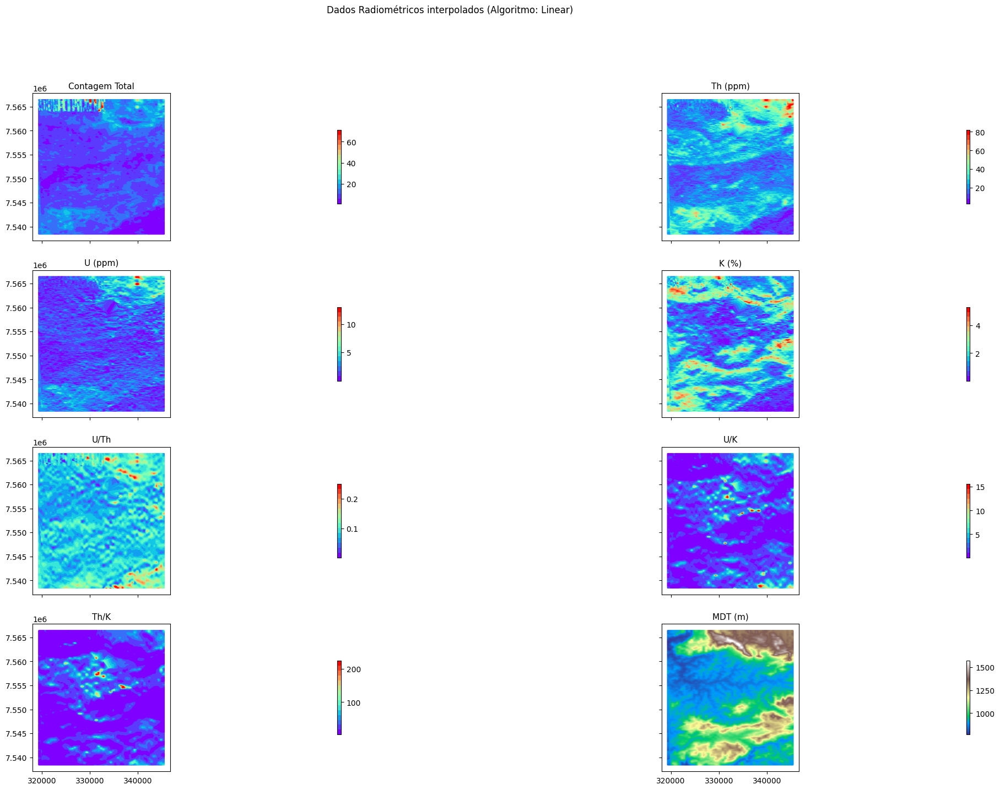

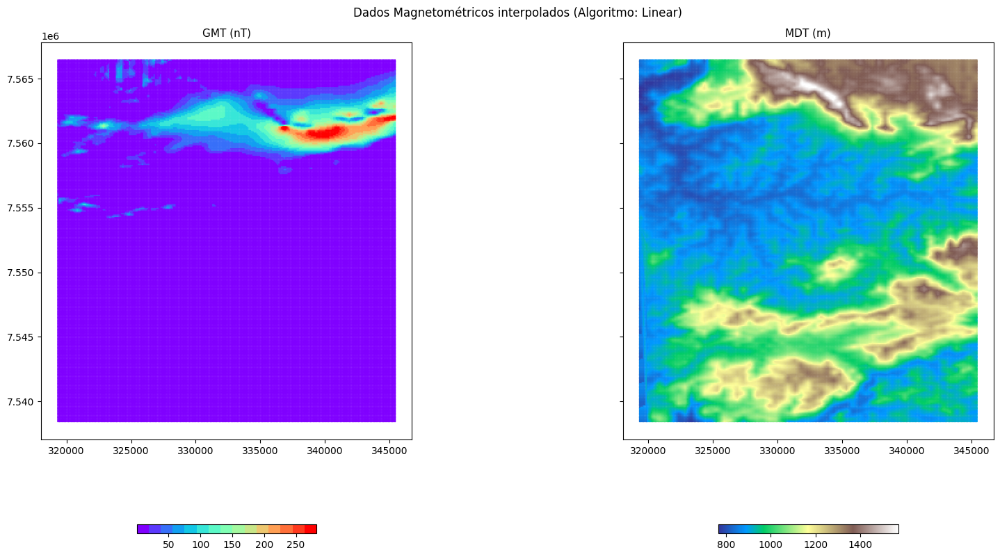

In [63]:
SF23_YA_III2 = quadricula['SF23_YA_III2']['geof_1105_linear']
plot_histograms(SF23_YA_III2)

plot_boxplots(SF23_YA_III2,gama_FEAT)

plot_raw_gama_data(SF23_YA_III2,suptitle='Dados Radiométricos interpolados (Algoritmo: Linear)',figsize=(27,16))

SF23_YA_III2.rename(columns={'GMT':'MAGIGRF'},inplace=True)
plot_raw_mag_data(SF23_YA_III2,suptitle='Dados Magnetométricos interpolados (Algoritmo: Linear)')

In [ ]:
plot_raw_gama_data(df,suptitle='Dados Radiométricos interpolados (Algoritmo: Linear)',figsize=(27,16))
df.rename(columns={'GMT':'MAGIGRF'},inplace=True)
plot_raw_mag_data(df,suptitle='Dados Magnetométricos interpolados (Algoritmo: Linear)')

x: 100.3297046847816 y: 100.19910621095956
['MDT', 'CTCOR', 'KPERC', 'eU', 'eTh', 'MAGIGRF', 'UTHRAZAO', 'UKRAZAO', 'THKRAZAO']


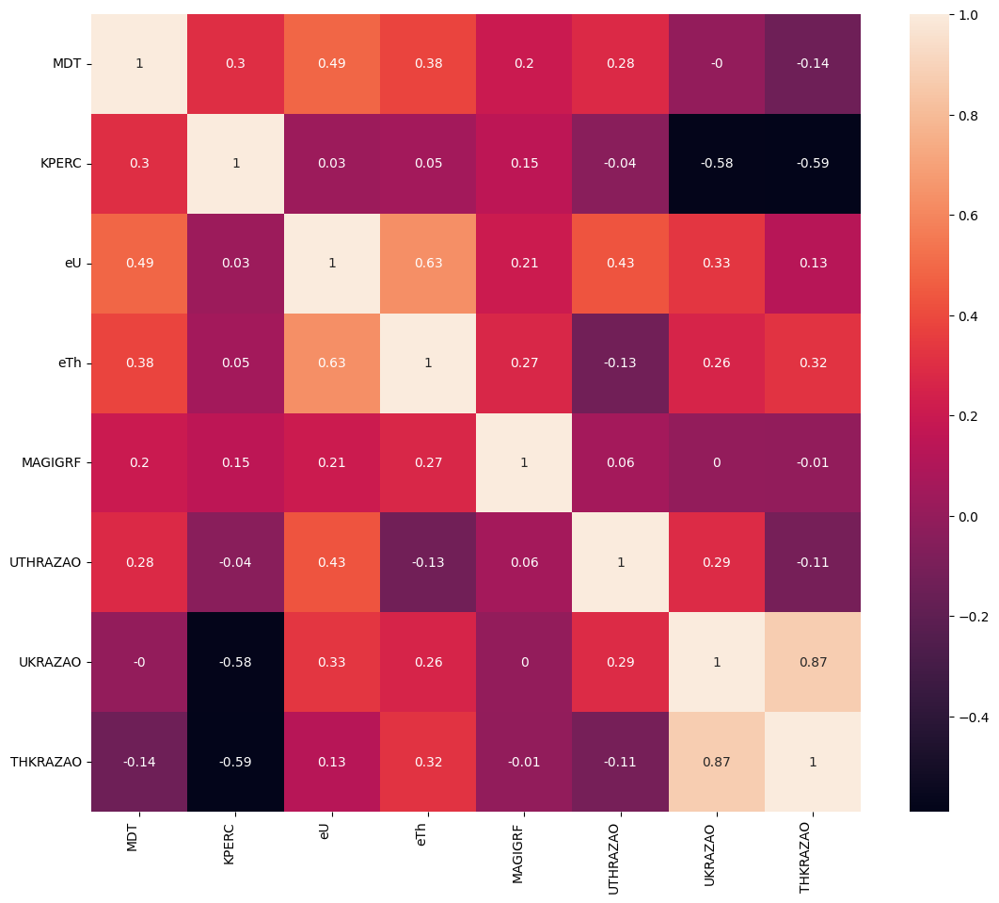

In [83]:
SF23_YA_III2.rename(columns={'X':'E_utm','Y':'N_utm'},inplace=True)
#df_rs.fillna(0,inplace=True)

xpixel_size = (SF23_YA_III2.E_utm.max()-SF23_YA_III2.E_utm.min())/SF23_YA_III2.E_utm.unique().size
ypixel_size = (SF23_YA_III2.N_utm.max()-SF23_YA_III2.N_utm.min())/SF23_YA_III2.N_utm.unique().size
print('x:', xpixel_size, 'y:', ypixel_size)

nx=SF23_YA_III2.E_utm.unique().size
ny=SF23_YA_III2.N_utm.unique().size
ratio=ny/nx
xs = SF23_YA_III2.E_utm.values.reshape(ny, nx)
ys = SF23_YA_III2.N_utm.values.reshape(ny, nx)

all_features = list(SF23_YA_III2.columns[2:])
print(all_features)

features=['MDT', 'KPERC', 'eU', 'eTh', 'MAGIGRF', 'UTHRAZAO', 'UKRAZAO', 'THKRAZAO']

plot_corr(SF23_YA_III2[features], size=11)
#plt.savefig('figs/correlation_matrix.png', dpi=400, bbox_inches='tight')

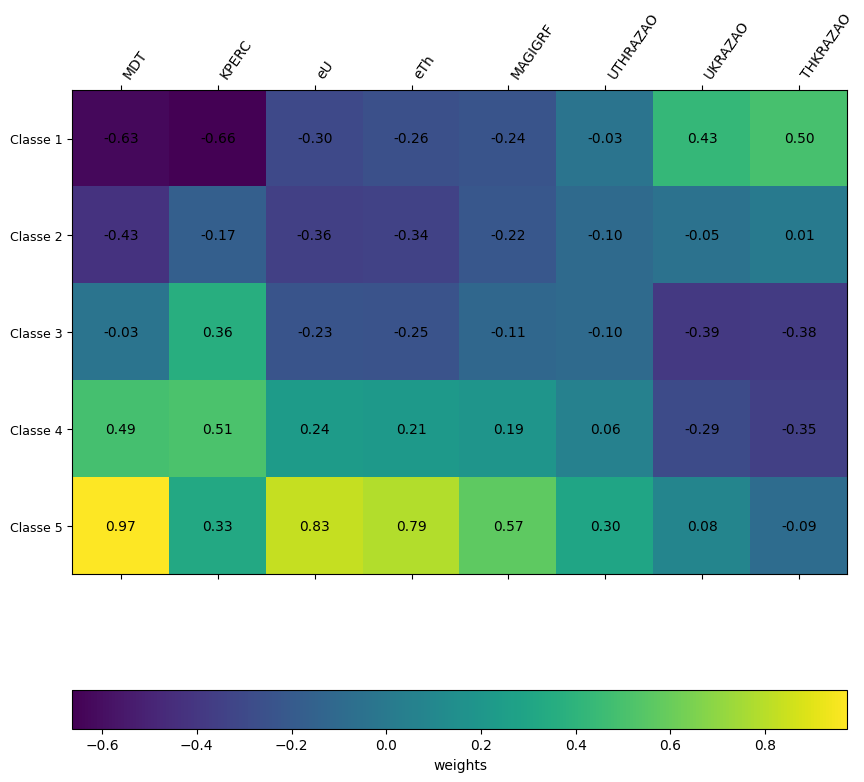

In [91]:
data = StandardScaler().fit_transform(SF23_YA_III2[features].values)

# data = df_rs[features].values

# NÚMERO DE CLASSES
n_clusters=5
lito_SOM = SOM(m=n_clusters,
               n=1,
           sigma=1.5,
             dim=len(features),
        max_iter=10000)

lito_SOM.fit(data)

# predição de classes
predictions = lito_SOM.predict(data)

# create labels
cluster_labels=[]
for i in range(n_clusters):
    cluster_labels+=[f'Classe {i+1}']
    
# classes weights
fig, ax = plt.subplots(figsize=(19,19))
im=ax.matshow(lito_SOM.weights)
for (i, j), z in np.ndenumerate(lito_SOM.weights):
    ax.text(j, i, '{:0.2f}'.format(z), ha='center', va='center')

plt.yticks(range(n_clusters), cluster_labels, fontsize=9)
plt.xticks(range(len(features)), features, rotation=55, fontsize=10, ha='left')
fig.colorbar(im, label='weights', orientation='horizontal')
plt.gca().set_aspect('equal')
plt.gcf().set_size_inches(10, 10)
plt.show()

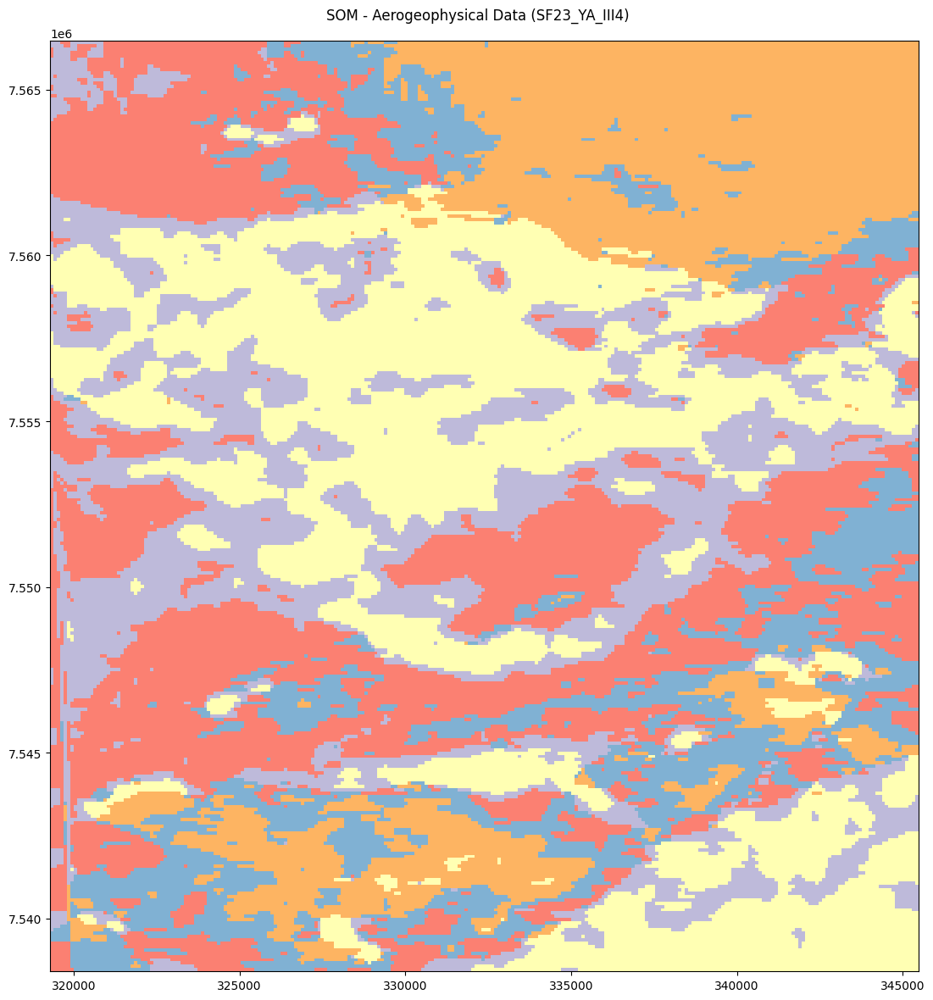

In [92]:
id_ = [1,2,3,4,5]
relcolor =  matplotlib.cm.Set3
colors = np.array(relcolor.colors)[id_]
relcolor = matplotlib.colors.ListedColormap(colors)

idxs=np.arange(0, n_clusters, 1)
half=(idxs[1]-idxs[0])/2
ticks=np.linspace(idxs[0]+half, idxs[-1]-half, n_clusters)

datafig, ax=plt.subplots(figsize=(12, 12), facecolor='w')
im=plt.pcolormesh(xs, ys, predictions.reshape(ny, nx), cmap=relcolor, shading='auto')
plt.xlim(xs.min(), xs.max())
plt.ylim(ys.min(), ys.max())

cbar_ax = fig.add_axes([0.93, 0.3, 0.05, 0.4])
cbar = fig.colorbar(im, cax=cbar_ax, label = u'Classes', orientation='vertical',cmap='viridis',ticks=ticks)
cbar.ax.set_yticklabels(cluster_labels, fontsize=8)


plt.suptitle('SOM - Aerogeophysical Data (SF23_YA_III4)')
plt.axis('scaled')
plt.tight_layout()
plt.show()


### SF23_YA_III4

            count        mean         std         min        0.1%          1%   
CTCOR     72540.0    6.556830    2.713995    1.382123    1.918697    2.511803  \
eTh       72540.0   14.111952    5.510771    1.681087    3.412660    5.263821   
eU        72540.0    1.631743    0.700655    0.001000    0.053025    0.273024   
KPERC     72540.0    1.097175    0.695084    0.001000    0.012373    0.080317   
MDT       72540.0  856.902556  101.569635  627.918941  631.338414  648.888914   
THKRAZAO  72540.0   19.543967   16.943119    2.929159    3.615296    4.550159   
UTHRAZAO  72540.0    0.121622    0.036082    0.016837    0.035372    0.054940   
UKRAZAO   72540.0    2.345212    2.136472    0.146864    0.294002    0.468174   

                  5%         25%         50%         75%       99.95%   
CTCOR       3.154540    4.431616    6.048591    8.173215    18.402186  \
eTh         7.069359   10.068416   13.000383   17.348894    43.680056   
eU          0.608489    1.145814    1.557596    2.0

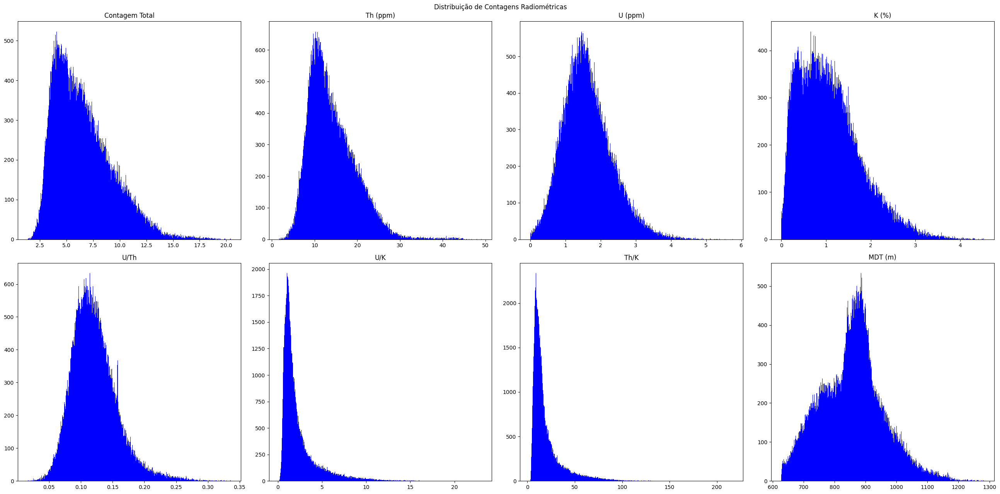

In [41]:
df = quadricula['SF23_YA_III4']['geof_1105_linear']
plot_histograms(df)

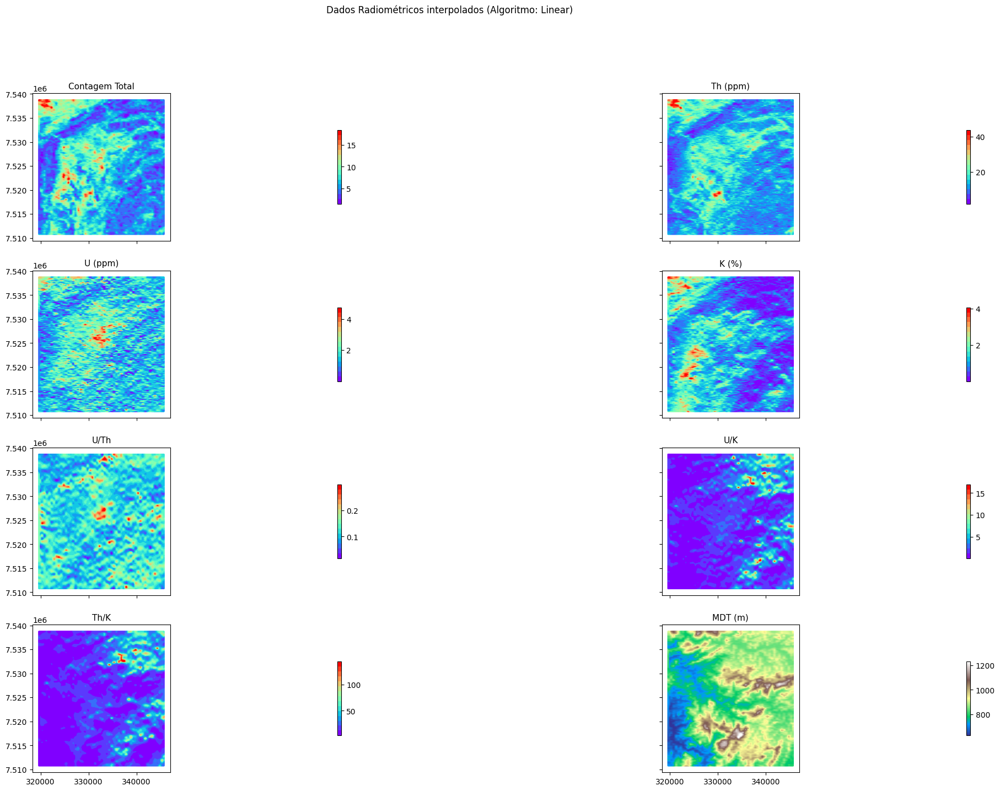

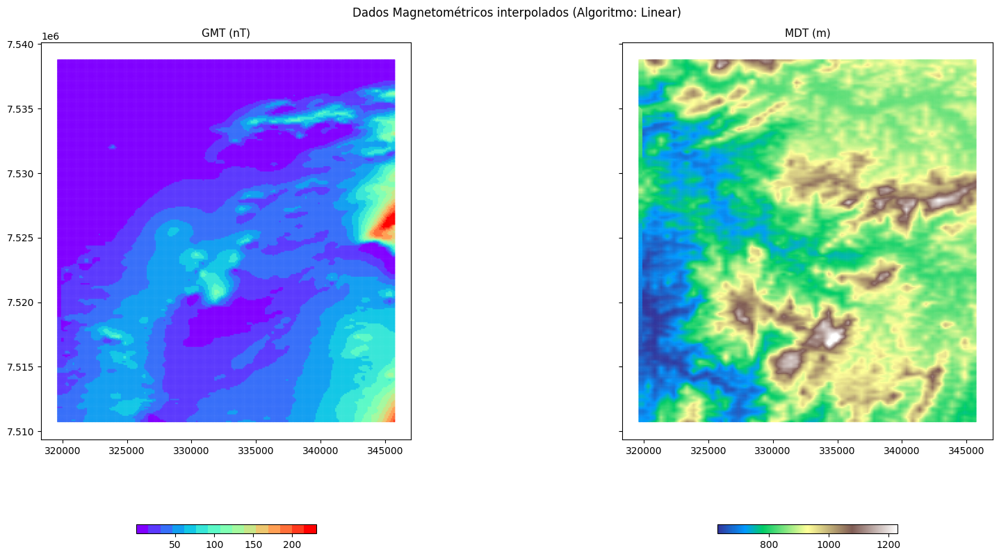

In [42]:
plot_raw_gama_data(df,suptitle='Dados Radiométricos interpolados (Algoritmo: Linear)',figsize=(27,16))
df.rename(columns={'GMT':'MAGIGRF'},inplace=True)
plot_raw_mag_data(df,suptitle='Dados Magnetométricos interpolados (Algoritmo: Linear)')

### Pixel size

x: 100.16579455615407 y: 100.21072649280123


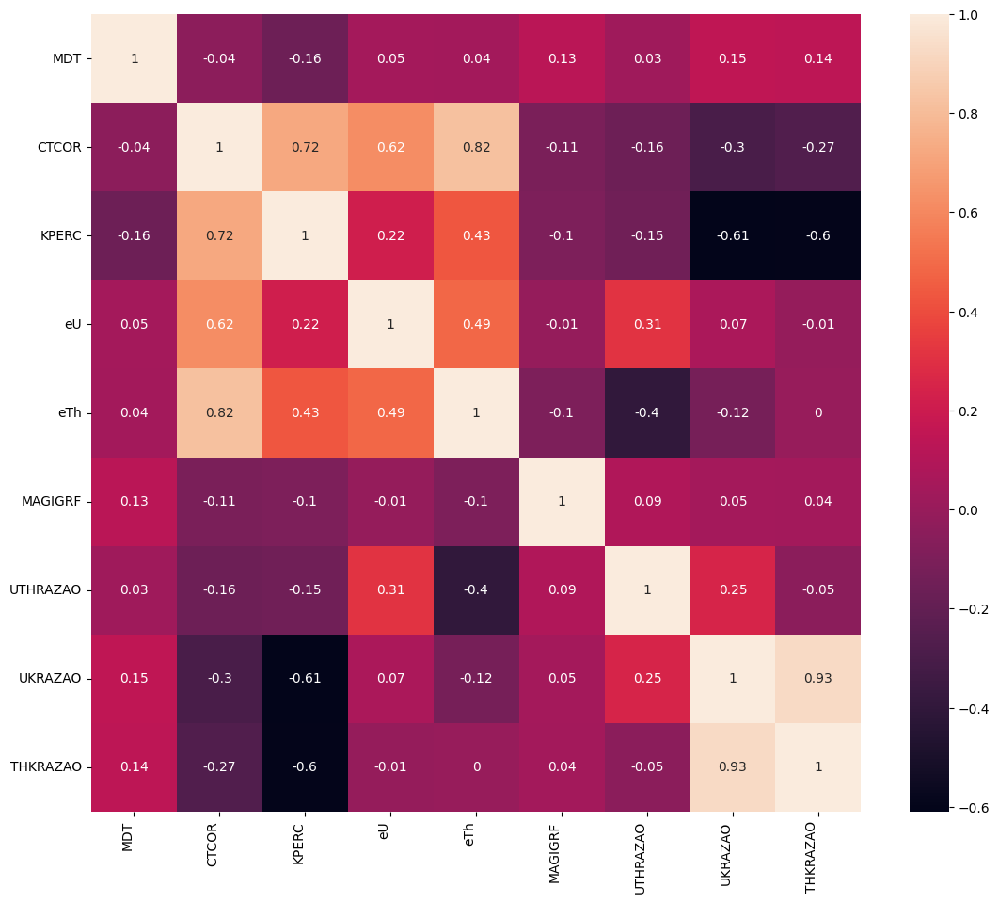

In [62]:
df_rs = df
df_rs.rename(columns={'X':'E_utm','Y':'N_utm'},inplace=True)
#df_rs.fillna(0,inplace=True)

xpixel_size = (df_rs.E_utm.max()-df_rs.E_utm.min())/df_rs.E_utm.unique().size
ypixel_size = (df_rs.N_utm.max()-df_rs.N_utm.min())/df_rs.N_utm.unique().size
print('x:', xpixel_size, 'y:', ypixel_size)

nx=df_rs.E_utm.unique().size
ny=df_rs.N_utm.unique().size
ratio=ny/nx
xs = df_rs.E_utm.values.reshape(ny, nx)
ys = df_rs.N_utm.values.reshape(ny, nx)

features = list(df_rs.columns[2:])

plot_corr(df_rs[features], size=11)
#plt.savefig('figs/correlation_matrix.png', dpi=400, bbox_inches='tight')

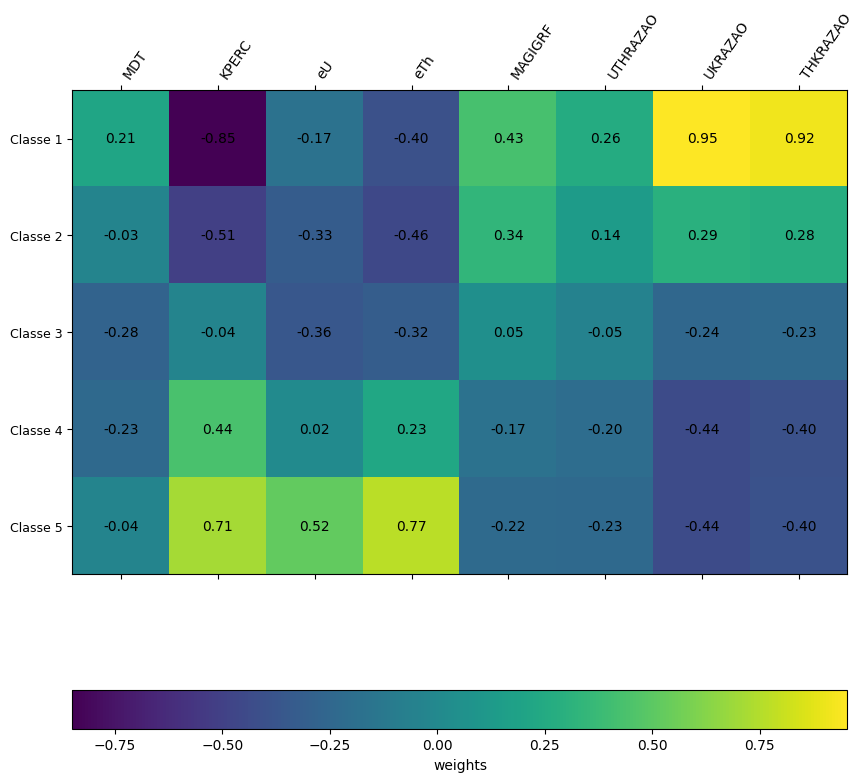

In [55]:
data = StandardScaler().fit_transform(df[features].values)

# data = df_rs[features].values

# NÚMERO DE CLASSES
n_clusters=5
lito_SOM = SOM(m=n_clusters,
               n=1,
           sigma=1.5,
             dim=len(features),
        max_iter=10000)

lito_SOM.fit(data)

# predição de classes
predictions = lito_SOM.predict(data)

# create labels
cluster_labels=[]
for i in range(n_clusters):
    cluster_labels+=[f'Classe {i+1}']
    
# classes weights
fig, ax = plt.subplots(figsize=(19,19))
im=ax.matshow(lito_SOM.weights)
for (i, j), z in np.ndenumerate(lito_SOM.weights):
    ax.text(j, i, '{:0.2f}'.format(z), ha='center', va='center')

plt.yticks(range(n_clusters), cluster_labels, fontsize=9)
plt.xticks(range(len(features)), features, rotation=55, fontsize=10, ha='left')
fig.colorbar(im, label='weights', orientation='horizontal')
plt.gca().set_aspect('equal')
plt.gcf().set_size_inches(10, 10)
plt.show()

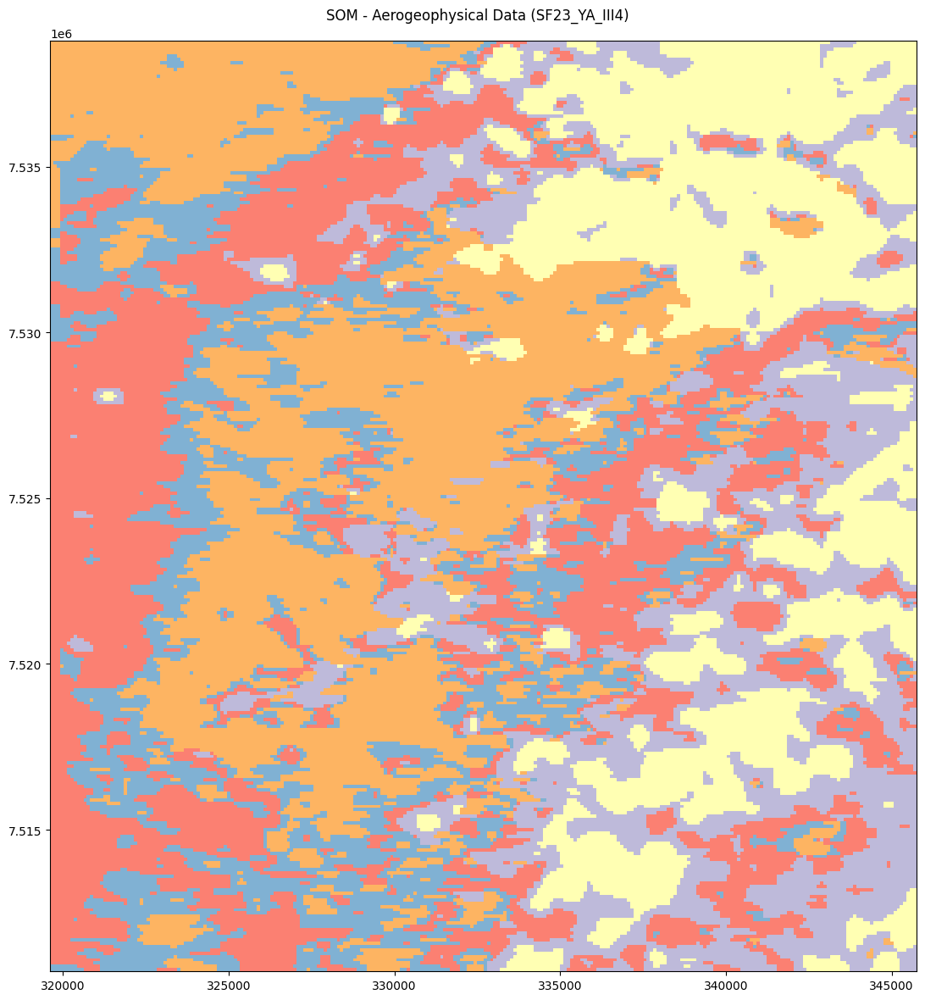

In [61]:
id_ = [1,2,3,4,5]
relcolor =  matplotlib.cm.Set3
colors = np.array(relcolor.colors)[id_]
relcolor = matplotlib.colors.ListedColormap(colors)

idxs=np.arange(0, n_clusters, 1)
half=(idxs[1]-idxs[0])/2
ticks=np.linspace(idxs[0]+half, idxs[-1]-half, n_clusters)

datafig, ax=plt.subplots(figsize=(12, 12), facecolor='w')
im=plt.pcolormesh(xs, ys, predictions.reshape(ny, nx), cmap=relcolor, shading='auto')
plt.xlim(xs.min(), xs.max())
plt.ylim(ys.min(), ys.max())

cbar_ax = fig.add_axes([0.93, 0.3, 0.05, 0.4])
cbar = fig.colorbar(im, cax=cbar_ax, label = u'Classes', orientation='vertical',cmap='viridis',ticks=ticks)
cbar.ax.set_yticklabels(cluster_labels, fontsize=8)


plt.suptitle('SOM - Aerogeophysical Data (SF23_YA_III4)')
plt.axis('scaled')
plt.tight_layout()
plt.show()


In [ ]:
n_clusters=11
lito_SOM = SOM(m=n_clusters, n=1, sigma=1.5, dim=len(features), max_iter=10000)
lito_SOM.fit(data)

# predição de classes
predictions = lito_SOM.predict(data)

# create labels
cluster_labels=[1,2,3,4,5,6,7,8,9,10,11]
for i in range(n_clusters):
    cluster_labels+=[f'Classe {i+1}']
    
# classes weights
fig, ax = plt.subplots(figsize=(27,27))
im=ax.matshow(lito_SOM.weights)

for (i, j), z in np.ndenumerate(lito_SOM.weights):
    ax.text(j, i, '{:0.2f}'.format(z), ha='center', va='center')

plt.yticks(range(n_clusters), cluster_labels, fontsize=8)
plt.xticks(range(len(features)), features, rotation=55, fontsize=9, ha='left')
fig.colorbar(im, label='weights', orientation='horizontal',cmap='Reds')
plt.gca().set_aspect('equal')
plt.gcf().set_size_inches(15, 10)
plt.show()

id_ = [1,2,3,4,5,6,7,8,9,10,11]

relcolor =  matplotlib.cm.Set3
colors = np.array(relcolor.colors)[id_]
relcolor = matplotlib.colors.ListedColormap(colors)

idxs=np.arange(0, n_clusters, 1)
half=(idxs[1]-idxs[0])/2
ticks=np.linspace(idxs[0]+half, idxs[-1]-half, n_clusters)

datafig, ax=plt.subplots(figsize=(12, 12), facecolor='w')
im=plt.pcolormesh(xs, ys, predictions.reshape(ny, nx), cmap=relcolor, shading='auto')
plt.xlim(xs.min(), xs.max())
plt.ylim(ys.min(), ys.max())
cbar_ax = fig.add_axes([0.93, 0.3, 0.05, 0.4])
cbar = fig.colorbar(im, cax=cbar_ax, label = u'Classes', orientation='vertical',
                    ticks=ticks)
cbar.ax.set_yticklabels(cluster_labels, fontsize=8)
plt.suptitle('SOM - Aerogeophysical Data ()')
plt.axis('scaled')
plt.show()

### Testes

In [ ]:
plt.figure(figsize=(24,16))

# PLOTANDO A MALHA CARTOGRÁFICA
for id in list(quadricula.keys()):
    carta=quadricula[id]
    plt.plot(*transform_to_carta_utm(carta['folha']).exterior.xy,color='black')
    
    # PLOTANDO OS DADOS INTERPOLADOS
    for data in list(carta.keys())[2:]:        
        if 'geof' in data:
            plt.scatter(carta[data].X,carta[data].Y,c=carta[data].eU,cmap='rainbow',s=0.5,marker='H')
            plt.axis('scaled')
        # SE NÃO TIVER DADOS NÃO PLOTA NADA
        else:
            pass
        
plt.suptitle('Área de cobertura dos levantamentos aerogeofísicos')
plt.tight_layout()

In [ ]:
df = quadricula['SF23_YA_III4']['geof_1105_linear']

plot_histograms(df)
plot_raw_gama_data(df,suptitle='Dados Radiométricos interpolados (Algoritmo: Linear)',figsize=(27,16))
plot_raw_mag_data(df,suptitle='Dados Magnetométricos i4nterpolados (Algoritmo: Linear)')


df_rs = df
df_rs.rename(columns={'X':'E_utm','Y':'N_utm'},inplace=True)
#df_rs.fillna(0,inplace=True)


xpixel_size = (df_rs.E_utm.max()-df_rs.E_utm.min())/df_rs.E_utm.unique().size
ypixel_size = (df_rs.N_utm.max()-df_rs.N_utm.min())/df_rs.N_utm.unique().size
print('x:', xpixel_size, 'y:', ypixel_size)


nx=df_rs.E_utm.unique().size
ny=df_rs.N_utm.unique().size
ratio=ny/nx
xs = df_rs.E_utm.values.reshape(ny, nx)
ys = df_rs.N_utm.values.reshape(ny, nx)

features = list(df_rs.columns[2:])
print(features)


plot_corr(df_rs[features], size=12)
#plt.savefig('figs/correlation_matrix.png', dpi=400, bbox_inches='tight')



scaler = StandardScaler()
data = scaler.fit_transform(df[features].values)
# data = df_rs[features].values


n_clusters=9
lito_SOM = SOM(m=n_clusters, n=1, sigma=1.5, dim=len(features), max_iter=10000)
lito_SOM.fit(data)

# predição de classes
predictions = lito_SOM.predict(data)

In [ ]:
# create labels
cluster_labels=[1,2,3,4,5,6,7,8,9]
for i in range(n_clusters):
    cluster_labels+=[f'Classe {i+1}']
    
# classes weights
fig, ax = plt.subplots(figsize=(19,26))
im=ax.matshow(lito_SOM.weights)
for (i, j), z in np.ndenumerate(lito_SOM.weights):
    ax.text(j, i, '{:0.2f}'.format(z), ha='center', va='center')

plt.yticks(range(n_clusters), cluster_labels, fontsize=9)
plt.xticks(range(len(features)), features, rotation=55, fontsize=10, ha='left')
fig.colorbar(im, label='weights', orientation='horizontal')
plt.gca().set_aspect('equal')
plt.gcf().set_size_inches(19, 26)
plt.show()

In [ ]:
id_ = [1,2,3,4,5,6,7,8,9]
relcolor =  matplotlib.cm.Set3
colors = np.array(relcolor.colors)[id_]
relcolor = matplotlib.colors.ListedColormap(colors)



idxs=np.arange(0, n_clusters, 1)
half=(idxs[1]-idxs[0])/2
ticks=np.linspace(idxs[0]+half, idxs[-1]-half, n_clusters)

datafig, ax=plt.subplots(figsize=(16, 16), facecolor='w')
im=plt.pcolormesh(xs, ys, predictions.reshape(ny, nx), cmap=relcolor, shading='auto')
plt.xlim(xs.min(), xs.max())
plt.ylim(ys.min(), ys.max())
cbar_ax = fig.add_axes([0.93, 0.3, 0.05, 0.4])
cbar = fig.colorbar(im, cax=cbar_ax, label = u'Classes', orientation='vertical',
                    ticks=ticks)
cbar.ax.set_yticklabels(cluster_labels, fontsize=8)
plt.suptitle('SOM - Aerogeophysical Data (SF23_YA_III4)')
plt.axis('scaled')
plt.show()

# Classificações Supervisionadas

## Rotulando amostras com classes litológicas

In [ ]:
import shapely.speedups
from shapely import geometry
shapely.speedups.enable()

geof_1089_linear['geometry'] = [geometry.Point(x,y) for x, y in zip(geof_1089_linear['X'], geof_1089_linear['Y'])]
gdf_1089_linear = geof_1089_linear.set_geometry('geometry')

gdf_1089_linear.set_crs('EPSG:32723',inplace=True)
gdf_1089_linear.geometry

In [ ]:
Upload_litologia(quadricula,'litologia_100k')

In [ ]:
litologia=quadricula['SB24_ZB_II']['litologia_100k']
litologia.to_crs('EPSG:32724',inplace=True)
print(litologia.crs)
litologia.reset_index(drop=True,inplace=True)

dic_litologico = describe_geologico(litologia)
print(litologia.columns)

In [ ]:
print(dic_litologico['SIGLA']['len'])
print(dic_litologico['SIGLA']['lista'])
gdf_1089_linear

In [ ]:
litologia.plot('SIGLA',figsize=(16,16),legend=True)

In [ ]:
geof_1089_linear['closest_unit'] = geof_1089_linear['geometry'].apply(lambda x: litologia['SIGLA'].iloc[litologia.distance(x).idxmin()]) # .idxmin() Retorna o indice do menor valor 

In [ ]:
1:100.000geof_1089_linear.to_csv('/home/ggrl/database/csv/SB24_ZB_II_gama_linear_100m.csv',index=False)